# Flats [April 2021] - Red array

This reduction includes the data taken before the FIFI-LS series in April 2021.

The method followed to obtain the flats is the following:

1. First, for each spaxel $i$, I obtain a median spectrum: $f_i (\lambda) $ using all the spexels $i, j$ with $j=0,15$.

2. Then, I obtain a median spectrum from all the spaxels  $f (\lambda)$ assuming a series of constant factors to scale the different spaxel spectra to a median spectrum. I call these factors spatial flats ($flat_{spat; i}$).

3. At this point, I go back to the original spexels and obtain the spectral relative response (or spectral flat)
using the ratios:   $flat_{spec; i, j} (\lambda) = f (\lambda) / f_{i, j} (\lambda)$.

4. At the end, I merge the spaxel spectral flat and spexels spectral flat to obtain a merged one.

In this way, I obtain a cube of spectral responses and an array of spatial flats.
The spectral responses should be computable from laboratory values. The spatial flats depend on the illumination of 
the array and, in principle, can vary between laboratory and sky.
Also, I obtain a spatial flat for each calibration series and only one spectral flat common to all the series.


In [3]:
# Used if in non-interactive mode to skip tests
Test = True
BadPixels = False

# Red 

In [49]:
%matplotlib inline
import matplotlib.pyplot as plt
from fifipy.io import readSlopeFits
from fifipy.spectra import computeMedianSpatialSpectra, computeSplineFits
import numpy as np

caldirs = [
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_03_2017/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_02_2018/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_08_2018/',    
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_10_2018/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_02_2019/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_04_2019/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_10_2019/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_02_2020/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_08_2020/',
    '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_04_2021/'
          ]
signs = [-1, -1, 1, 1, -1, -1, -1, -1, 1, 1]
cfiles = [
    ['D105R_1.fits','D130R_1.fits'],
    ['D105R_1.fits','D105R_2.fits','D105R_3.fits','D105R_5.fits',
     'D105R_6.fits','D130R_1.fits','D130R_2.fits','D130R_3.fits'],
    ['D130R_1.fits','D130R_2.fits','D105R_1.fits','D105R_2.fits'],
    ['D105R.fits','D105R_1.fits','D105R_2.fits','D130R.fits','D130R_1.fits'],
    ['D105R_1.fits','D105R_2.fits','D130R_1.fits','D130R_2.fits'],
    ['D105R_1.fits','D105R_2.fits','D105R_3.fits','D130R_3.fits','D130R_5.fits'],
    ['D105R_2.fits','D105R_3.fits','D105R_7.fits','D130R_1.fits','D130R_2.fits','D130R_3.fits'],
    ['D105R_1.fits','D105R_2.fits','D130R_1.fits','D130R_2.fits'],
    ['D105R_1.fits','D105R_2.fits','D105R_3.fits','D130R_1.fits','D130R_2.fits'],
    ['D105R_1.fits','D105R_2.fits','D105R_3.fits','D130R_1.fits','D130R_2.fits']    
]

dichroics = [[105,130],
             [105,105,105,105,105,130,130,130],
             [130,130,105,105],
             [105,105,105,130,130],
             [105,105,130,130],
             [105,105,105,130,130],
             [105,105,105,130,130,130],
             [105,105,130,130],
             [105,105,105,130,130],
             [105,105,105,130,130]
            ]
dates = [
        ['3/17']*2,
        ['2/18']*8,
        ['8/18']*4,
        ['10/18']*5,
        ['2/19']*4,
        ['4/19']*5,
        ['10/19']*6,
        ['2/20']*4,
        ['8/20']*5,
        ['4/21']*5,    
        ]

# To inspect badpixels
BadPixels = False
if BadPixels:
    cfiles = cfiles[-1:]
    caldirs = caldirs[-1:]
    signs = signs[-1:]
    dates = dates[-1:]
    dichroics = dichroics[-1:]
    
wmin = 100
wmax = 200
for files, caldir in zip(cfiles, caldirs):
    for file in files:
        g, w, dw, s = readSlopeFits(caldir, file)
        wmin_ = np.nanmin(w); wmax_ = np.nanmax(w)
        if wmin_ < wmin: wmin = wmin_
        if wmax_ > wmax: wmax = wmax_
    
waves = []
spectra = []
for files, caldir, sign, date, dichroic in zip(cfiles, caldirs, signs, dates, dichroics):
    for file, d, dic in zip(files, date, dichroic):
        g, w, dw, s = readSlopeFits(caldir, file)
        wave, spectrum = computeSplineFits(w,dw,s,'R', wmin, wmax)
        # Here I should mask stuff ...
        # Mask bad spaxels 2 and 20 for 4/21
        if d == '4/21':
            for pix in [2,20]:
                spectrum[np.arange(16)+pix*16,:] = np.nan
        # Mask leakage at 188um (check limits better)
        pixels = [0,1,5,6,9,10,11,14,15,16,19,20,21,23,24]
        idx = (wave > 186) & (wave < 187.5)
        for pix in pixels:
            for ipix in range(16):
                spectrum[ipix+pix*16,idx] = np.nan
                
        # Filter low signal parts
        if dic == 130:
            idx = (wave < 127)
            spectrum[:,idx] = np.nan                
        waves.append(wave)
        spectra.append(sign*spectrum)
 
spectra = np.array(spectra)
print(np.shape(spectra))

spatspectra = []
for spectrum in spectra:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra.append(spatspectrum)

spatspectra = np.array(spatspectra)  

# Concatenate
dichroics = np.concatenate(dichroics)
dates = np.concatenate(dates)

(48, 400, 768)


/Users/dfadda/Python/fifipy/fifipy/spectra.py:88: RuntimeWarning: Mean of empty slice
  mspec = np.nanmean(spec[m],axis=0)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/Python/fifipy/fifipy/spectra.py:81: RuntimeWarning: Mean of empty slice
  d.append(np.nanmean(np.array(r)))


Reading previous flats produced by Christian Fischer

In [50]:
# Grab Christian's flats
chrisdir = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/Christian/flats/'
wch = np.arange(119,207,1)
nw_ = np.size(wch)
f105 = np.ones((nw_,25,16))
f130 = np.ones((nw_,25,16))
ff105 = np.ones((nw_,25))
ff130 = np.ones((nw_,25))

nw = range(nw_)
for w,i in zip(wch,nw):
    wstr = str(w)
    try:
        f = np.loadtxt(chrisdir+wstr+'/flat.txt')
        f105[i,:,:] = f
        f = np.loadtxt(chrisdir+wstr+'/flatfield.txt')
        ff105[i,:] = f
    except:
        pass
    try:
        f = np.loadtxt(chrisdir+wstr+'_D130/flat.txt')
        f130[i,:,:] = f
        f = np.loadtxt(chrisdir+wstr+'_D130/flatfield.txt')
        ff130[i,:] = f
    except:
        pass

## Step 1

Find relative factors for different series.


/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

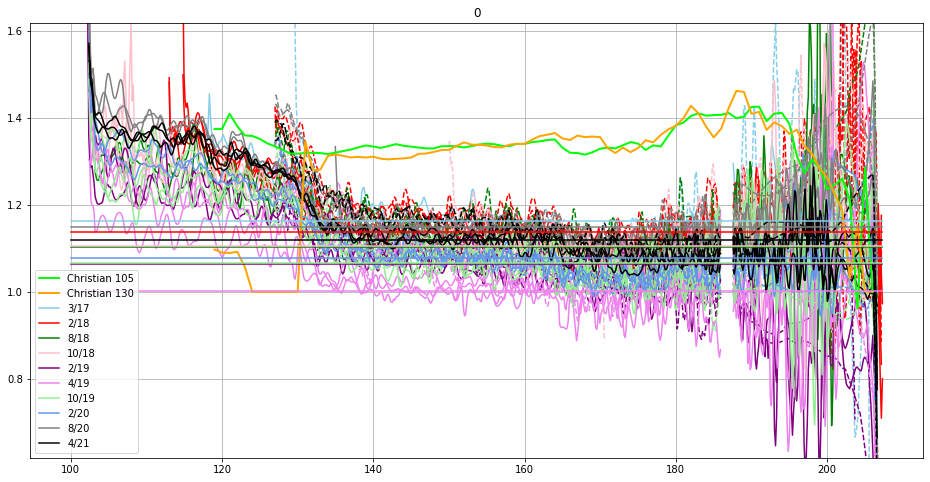

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

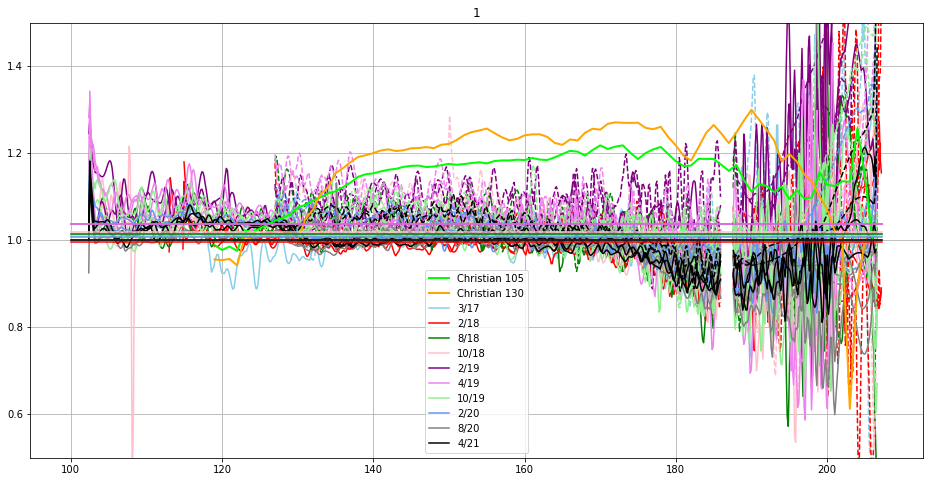

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

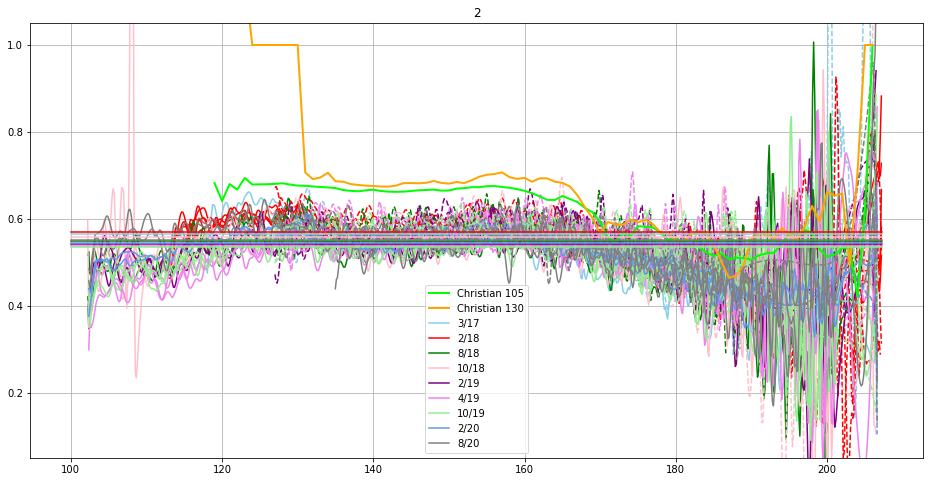

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

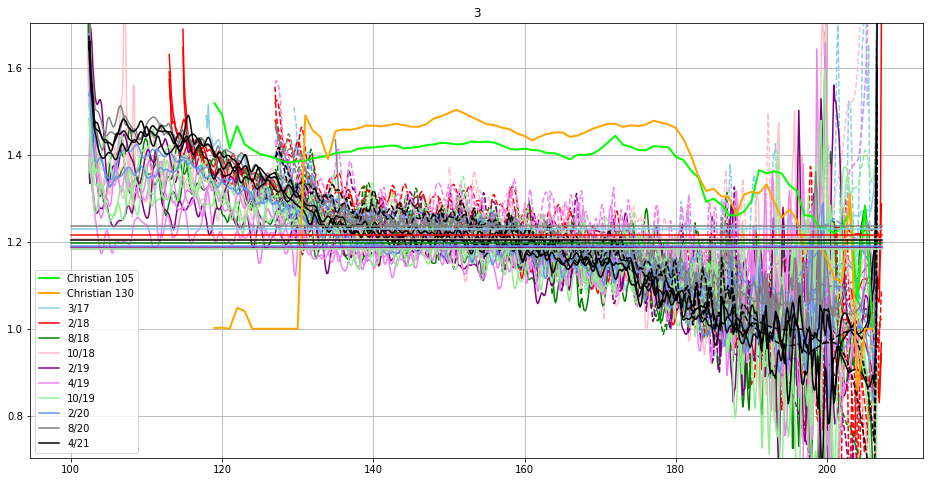

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

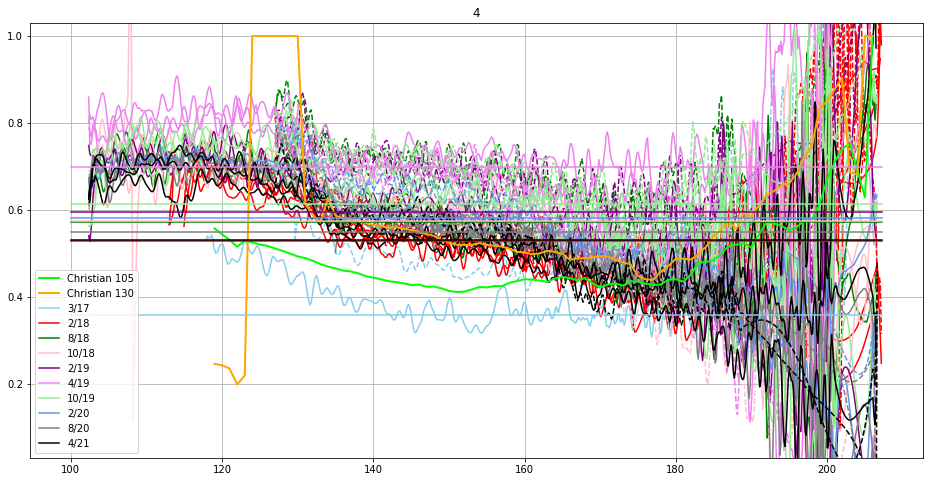

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

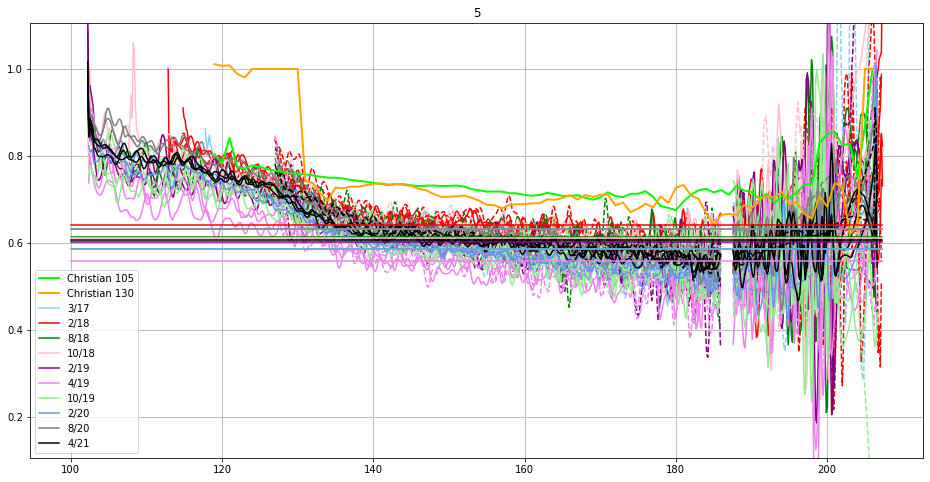

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

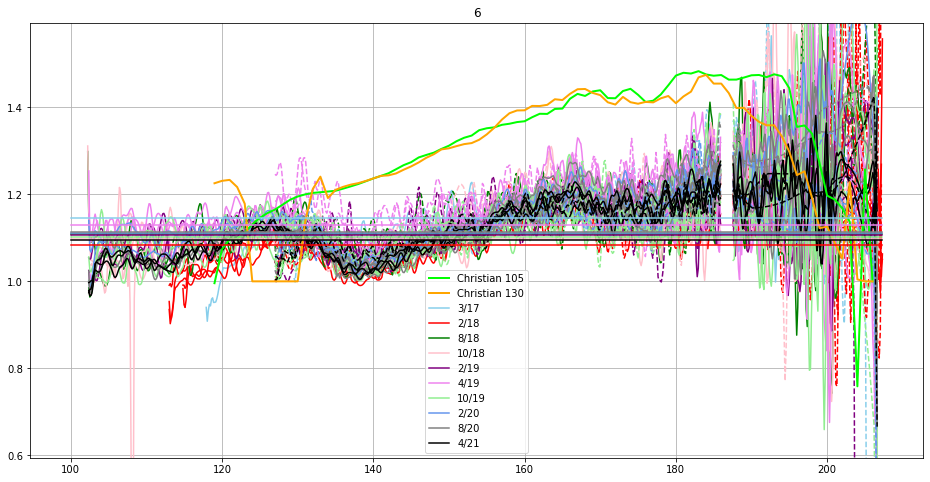

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

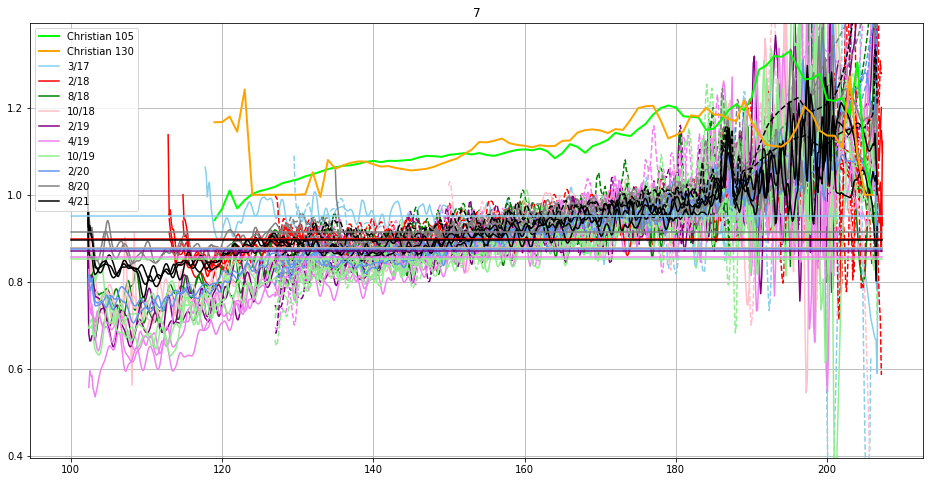

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

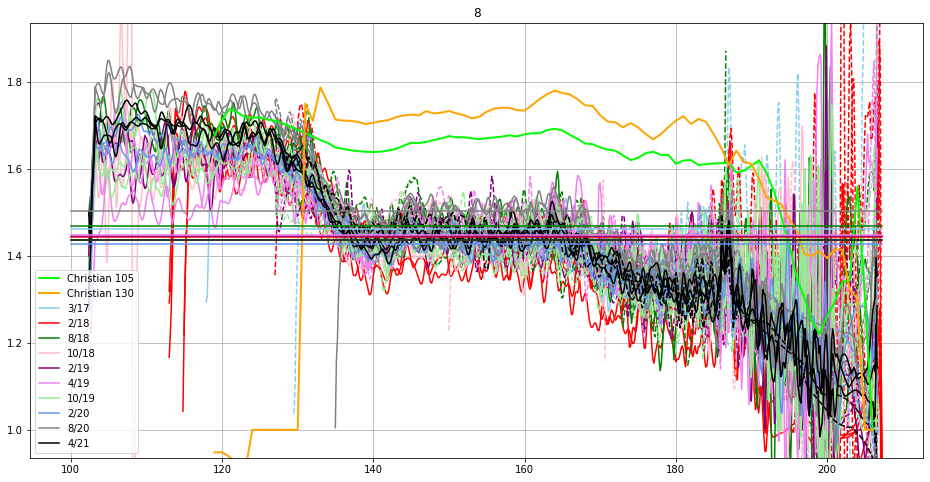

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

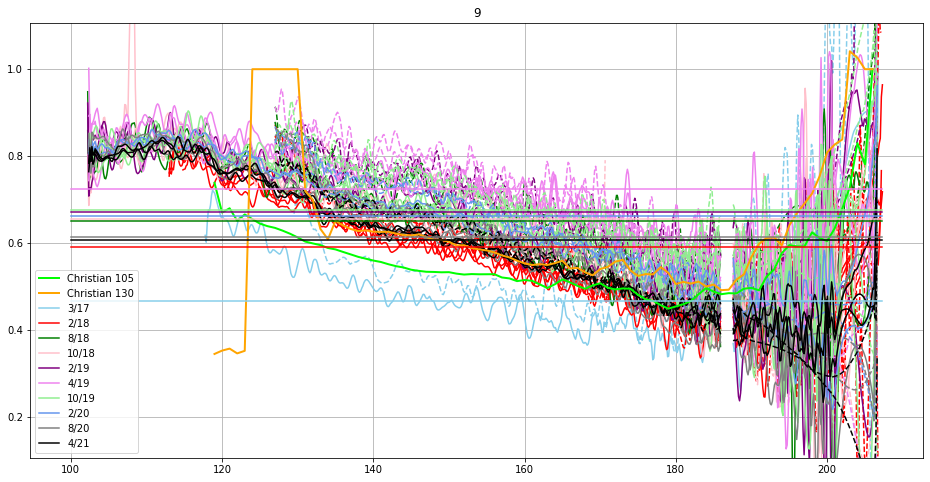

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

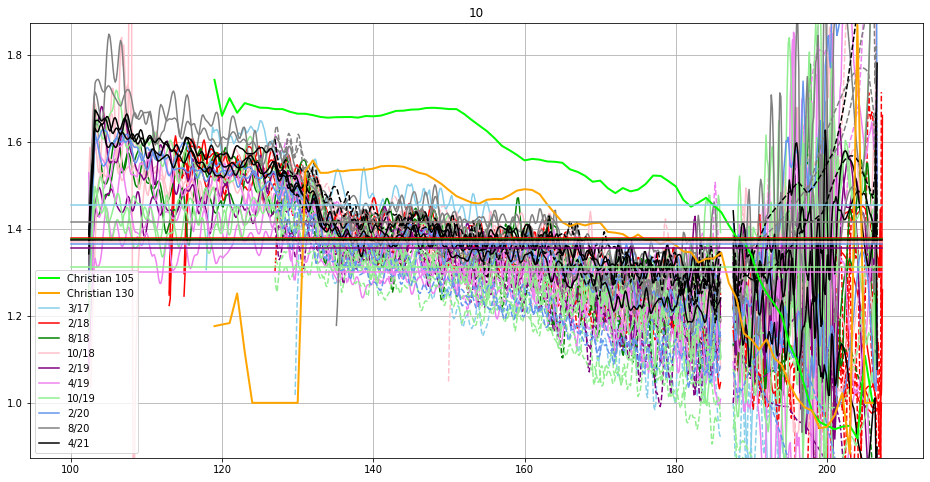

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

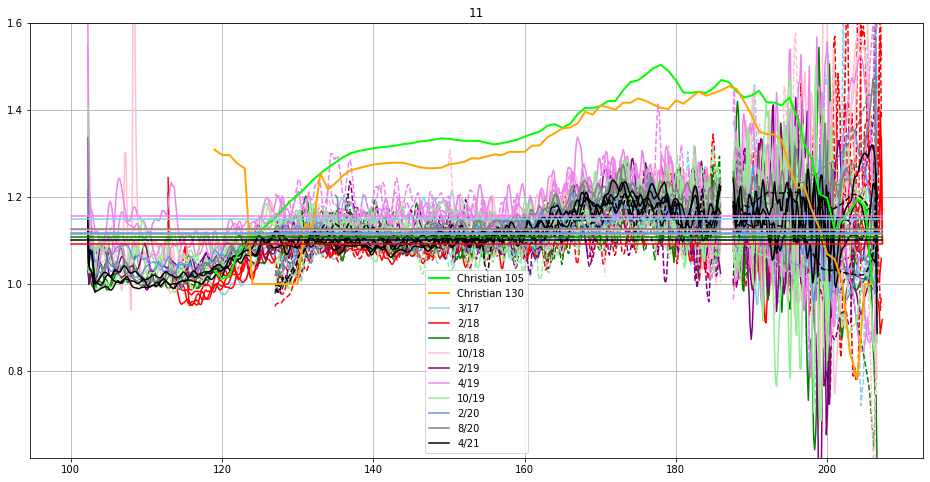

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

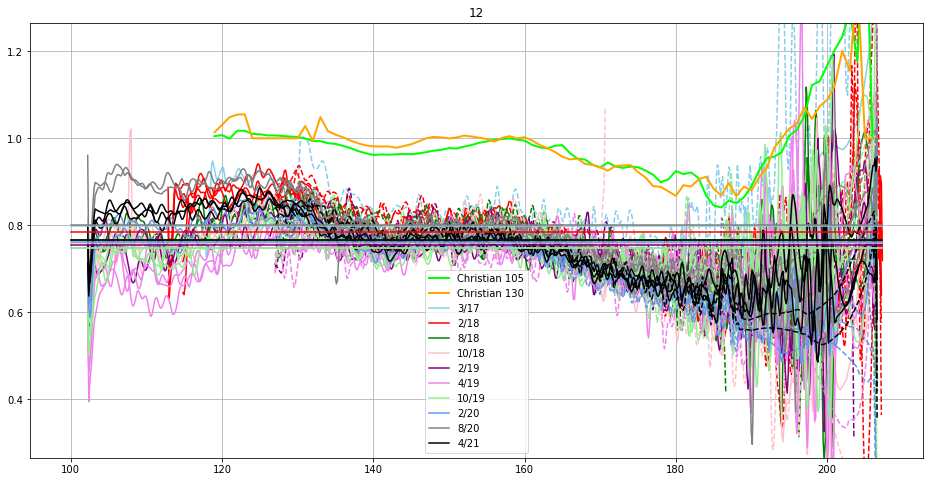

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

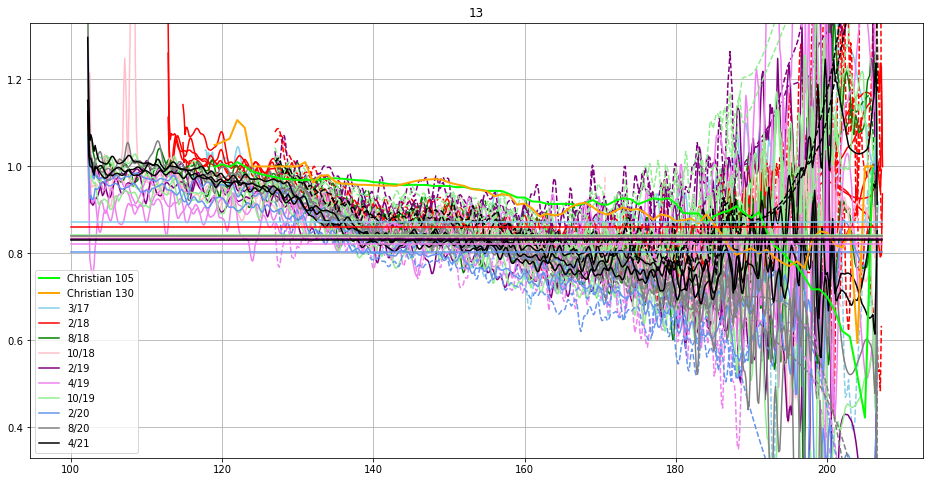

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

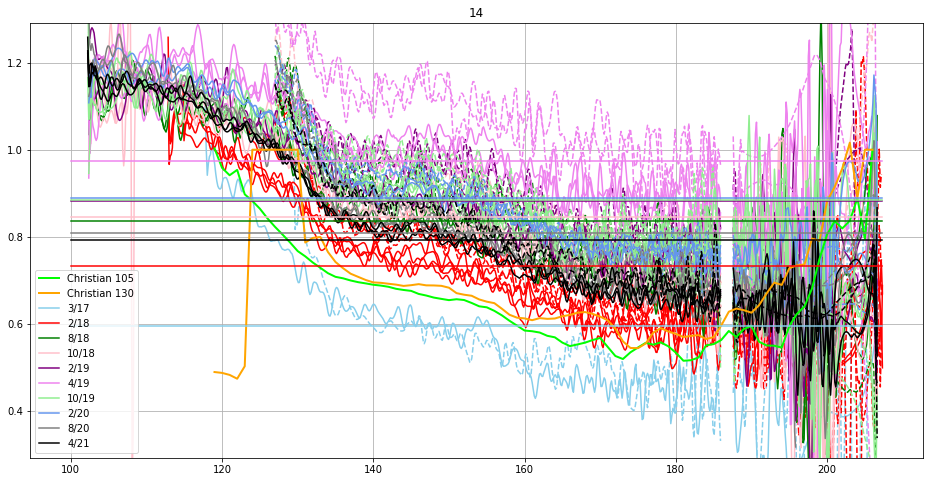

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

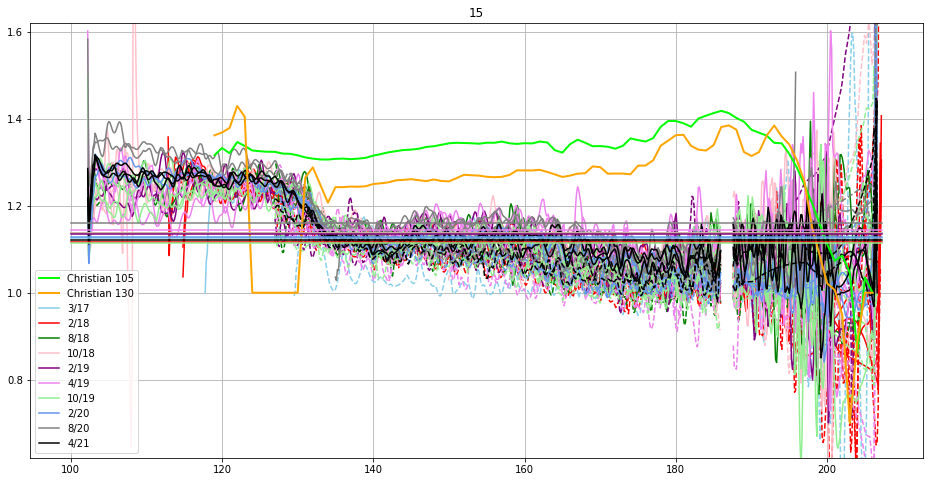

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

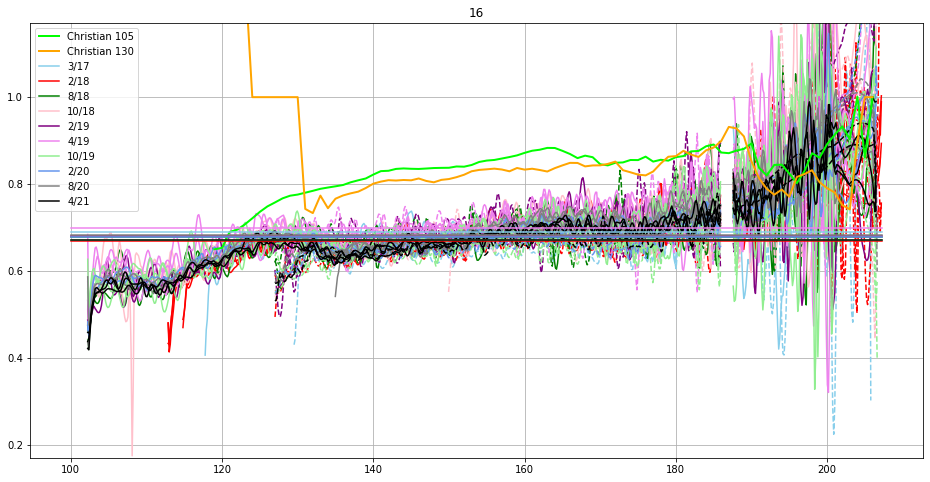

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

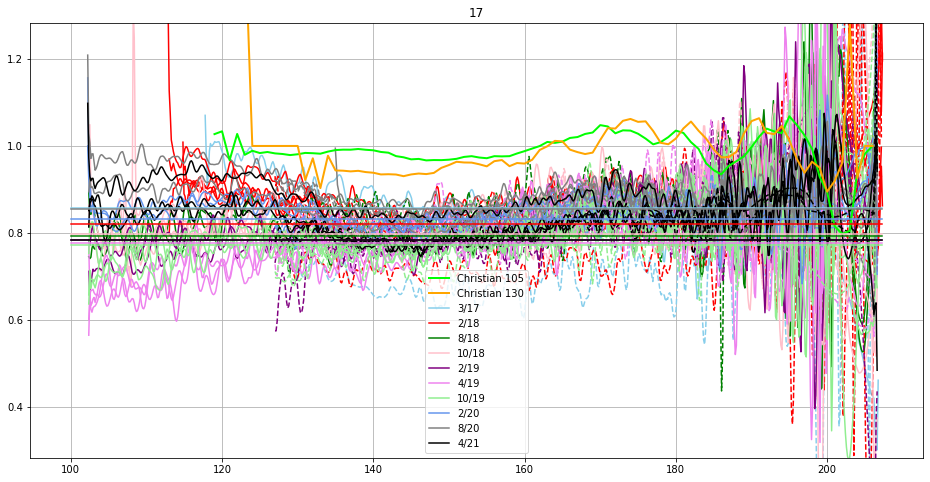

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

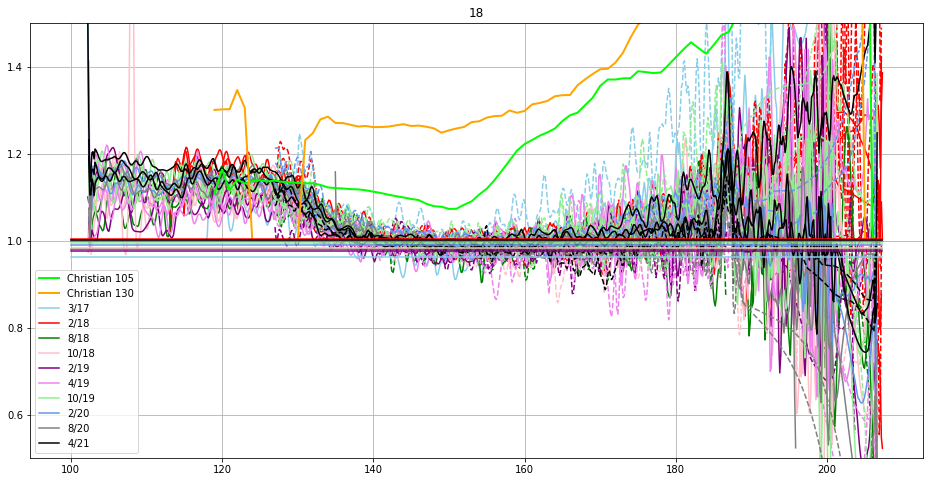

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

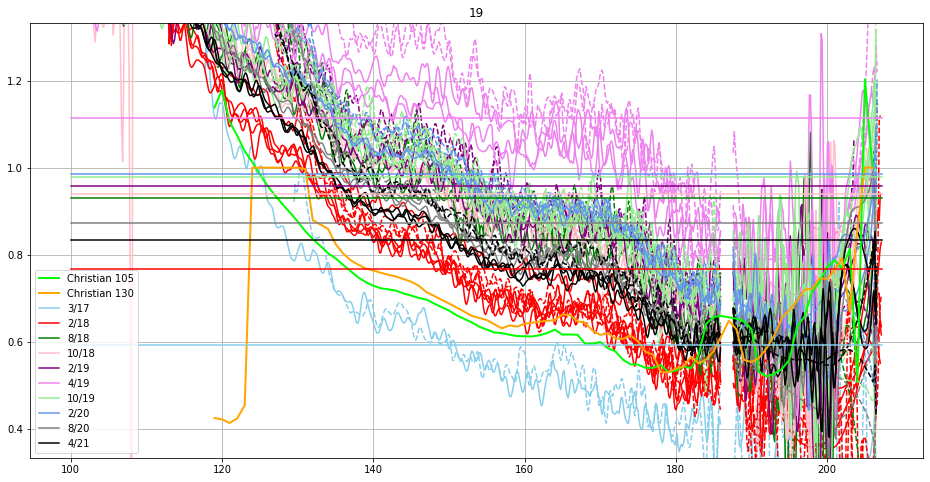

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

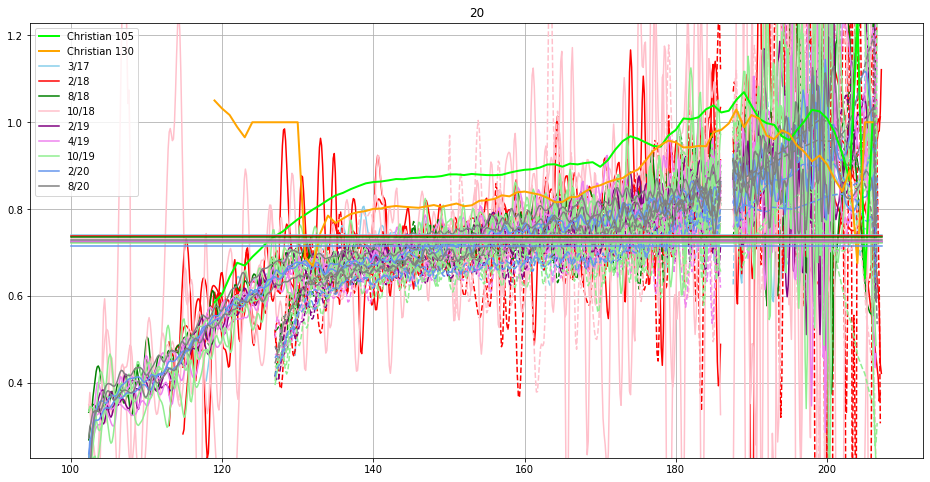

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

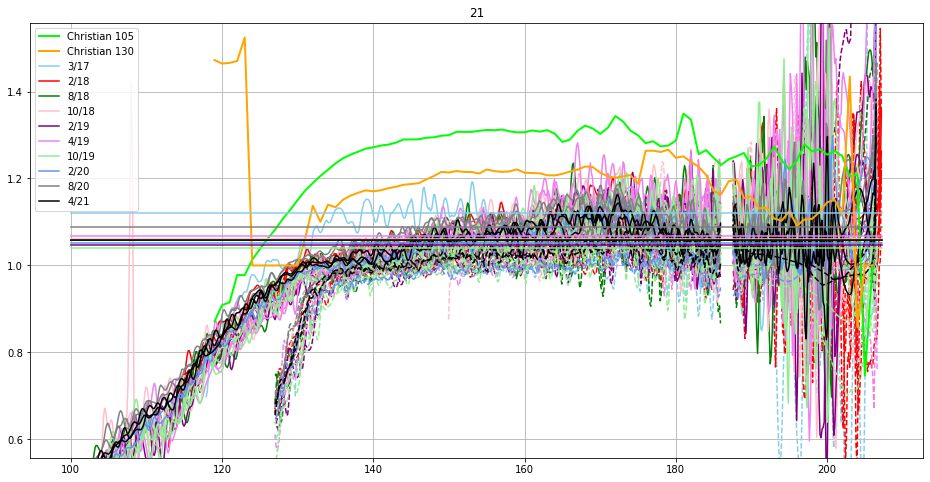

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

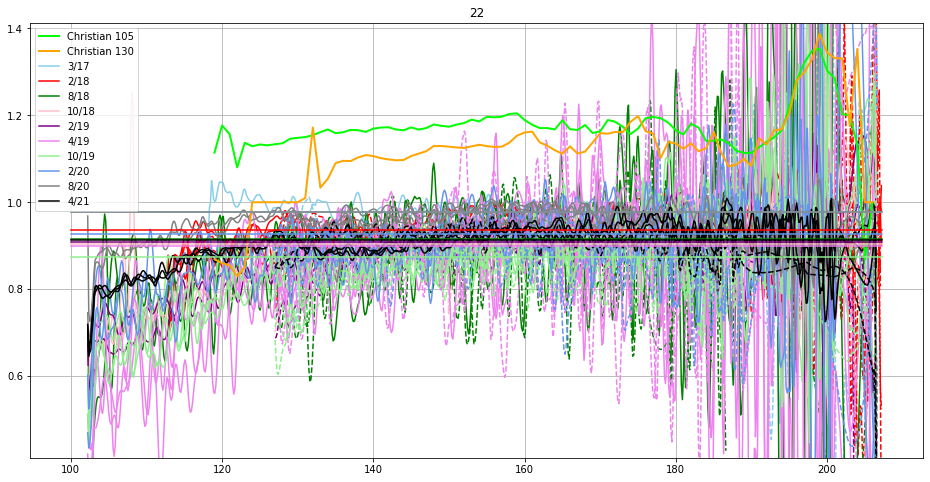

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

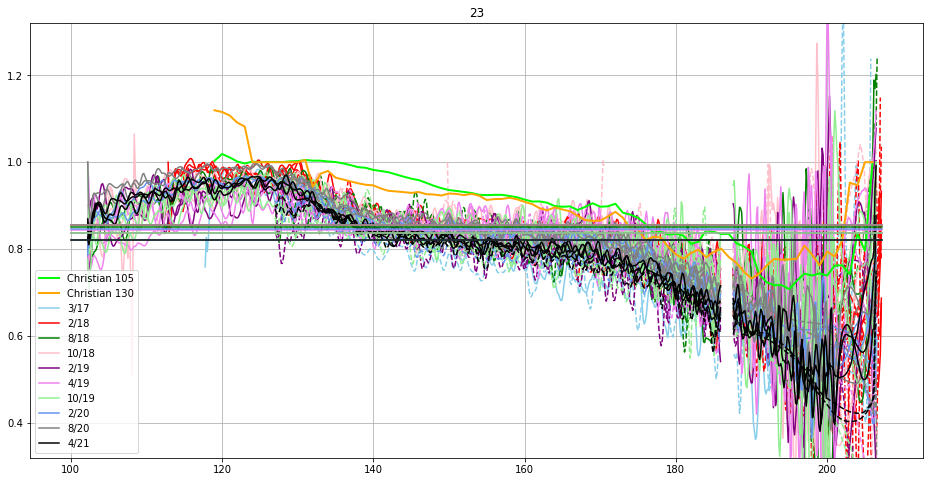

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

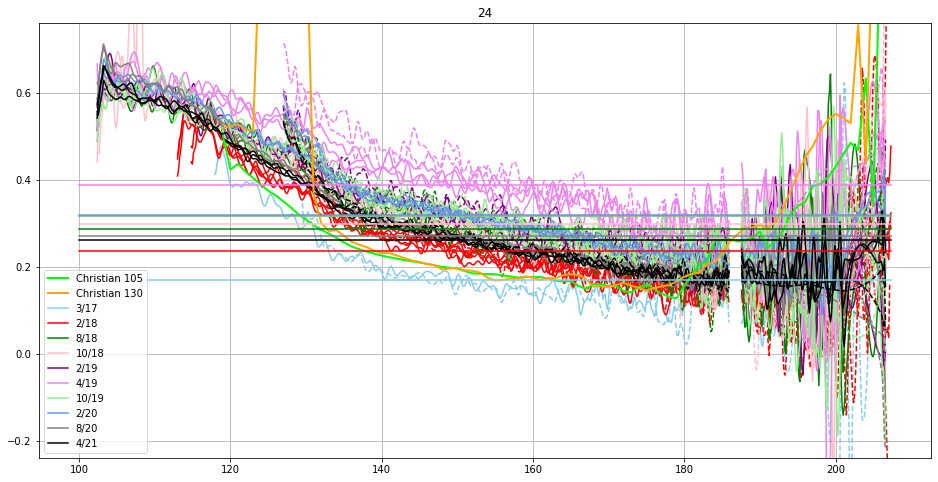

In [51]:
# Plot of  median spaxel spectra over median total spectra (except bad illuminated column)
from fifipy.stats import biweight

#colors = ['skyblue','red','green','pink','purple','violet','goldenrod']
colors = ['skyblue','red','green','pink','purple','violet','lightgreen','cornflowerblue','gray','black']

_, idx = np.unique(dates, return_index=True)
udates = dates[np.sort(idx)]
ndates = len(udates)
ssi = []
for i in range(ndates):
    ssi.append(np.ones(25))

#mask = [0,1,2,3,5,6,7,8,10,11,12,13,15,16,17,18,20,21,22,23]
mask = [0,1,3,5,6,7,8,10,11,12,13,15,16,17,18,21,22,23]  # 2 and 20 are dead in 04/2021
for ispax in range(25):
    fig,ax = plt.subplots(figsize=(16,8))
    mm = []
    for i in range(ndates):
        mm.append([])
    for w, s, d, dic in zip(waves, spatspectra, dates, dichroics):
        meds,sigs = biweight(s[mask,:], axis = 0)
        idw = (w > 140) & (w < 160)
        if (d == '4/21') & (ispax in [2,20]):
            m = np.nan
        else:
            m,sigs = biweight(s[ispax,idw]/meds[idw]) 
        for ud, mi, c in zip(udates, mm, colors):
            if d == ud:
                color = c
                if dic == 105:
                    mi.append(m)
        if dic == 105:
            line = '-'
        else:
            line = '--'
        if (d == '4/21') & (ispax in [2,20]):
            pass
        else:
            ax.plot(w, s[ispax,:]/meds, line, color=color)
    ax.plot(wch, ff105[:,ispax],color='lime',label='Christian 105',linewidth=2)
    ax.plot(wch, ff130[:,ispax],color='orange',label='Christian 130',linewidth=2)
    ax.set_title(str(ispax))
    for m, col, s, ud in zip(mm, colors, ssi, udates):
        m = np.array(m)
        medm = np.nanmedian(m)
        if np.isfinite(medm):
            ax.set_ylim(medm-0.5, medm+0.5)
            ax.plot(w, np.full(len(w), medm), color=col, label = ud)
            s[ispax] = medm
        else:
            s[ispax] = 1.
    ax.legend()
    #ax.set_xlim(184,190)
    ax.grid()
    plt.show()


## Step 2

Find relative response (to the median spectrum) for each spaxel normalized to the flats found in step 1.
In this way we can use all the data. 

The two dichroics will be treated separately.

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

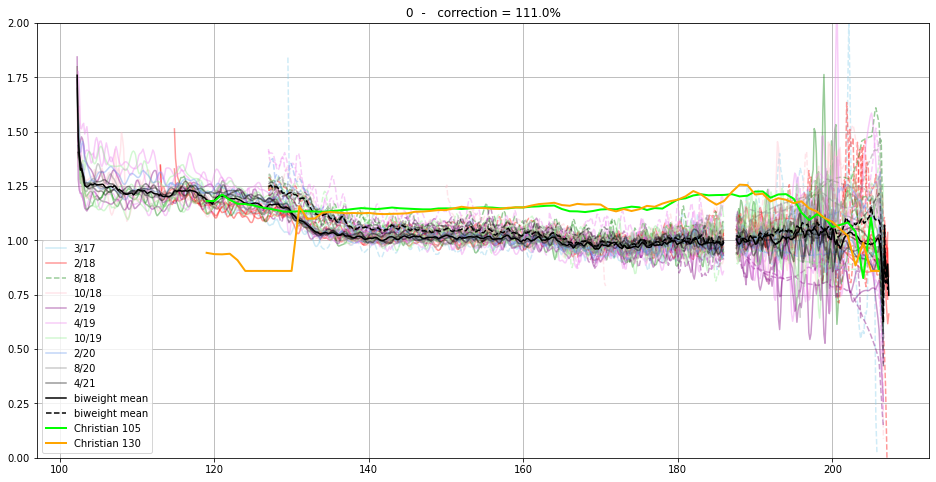

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

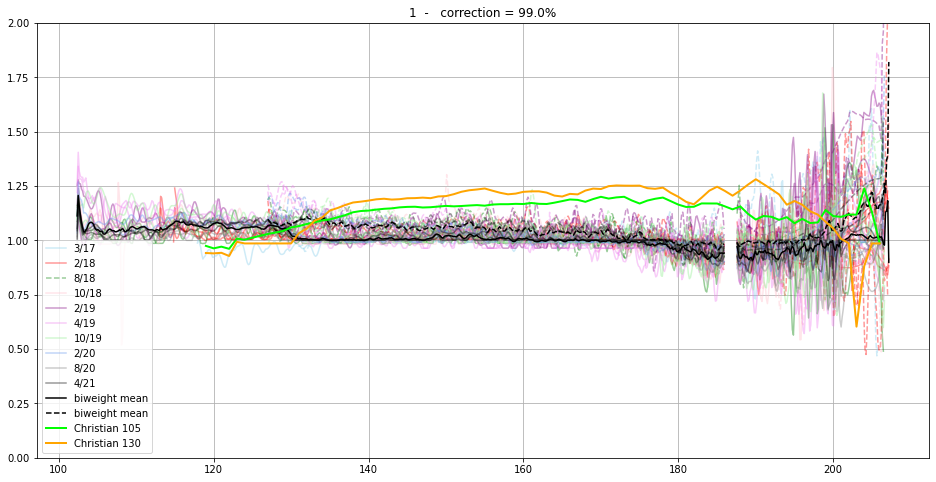

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

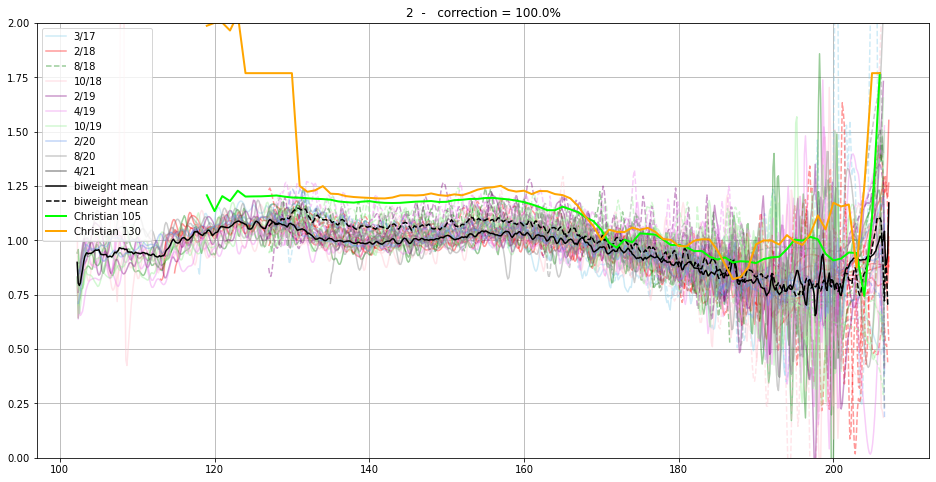

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

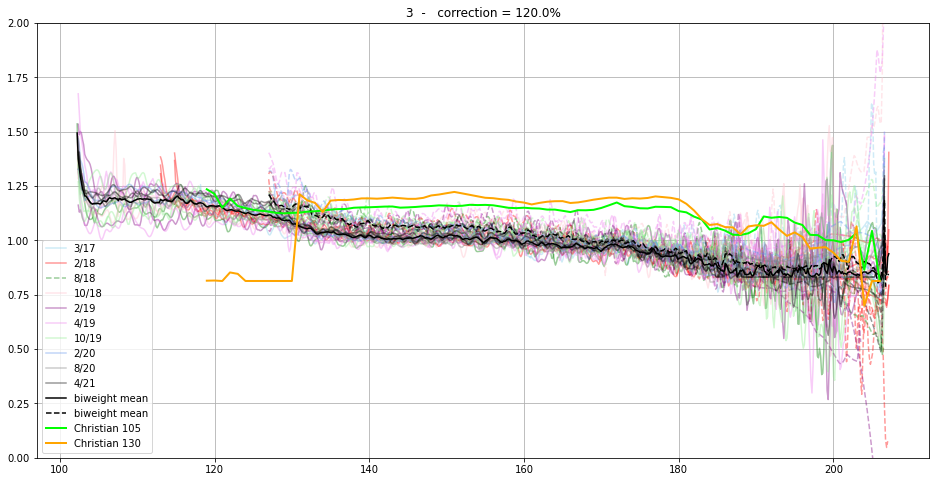

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

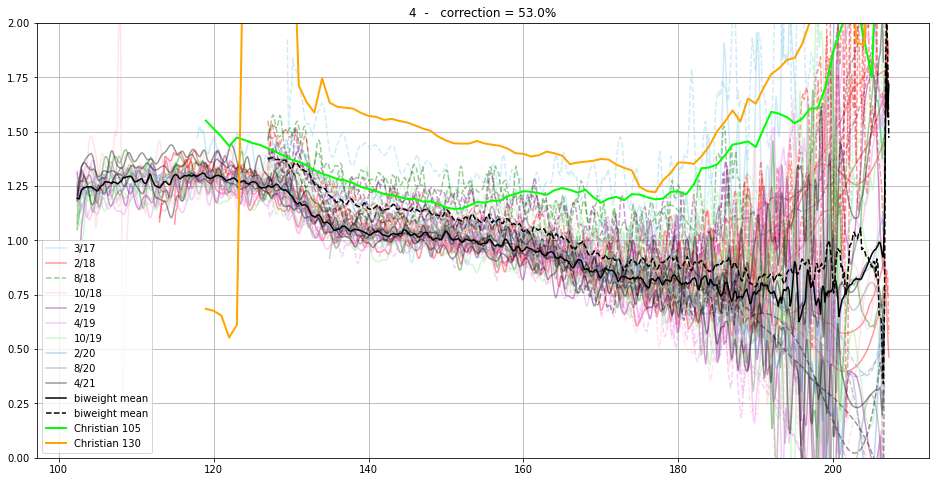

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

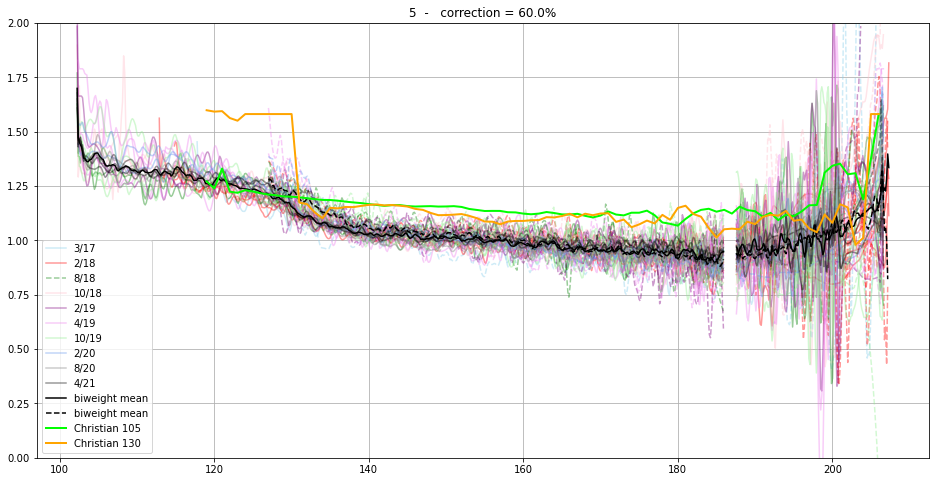

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

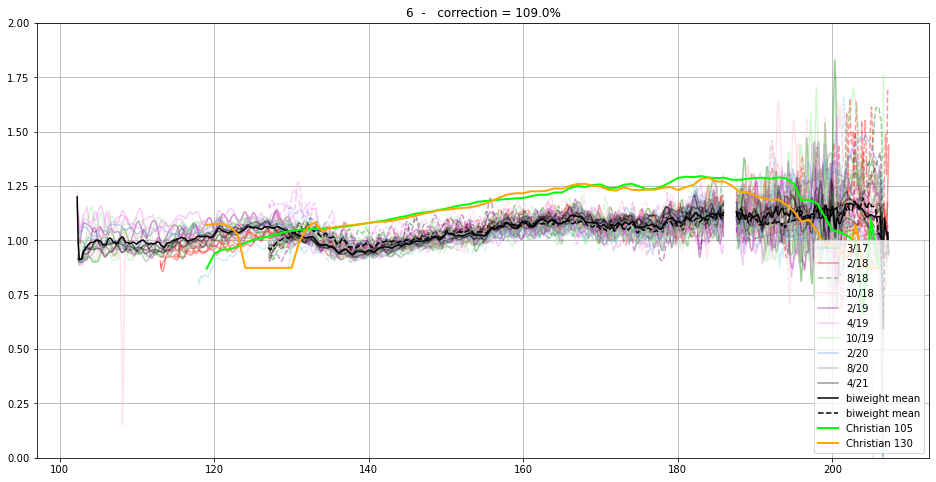

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

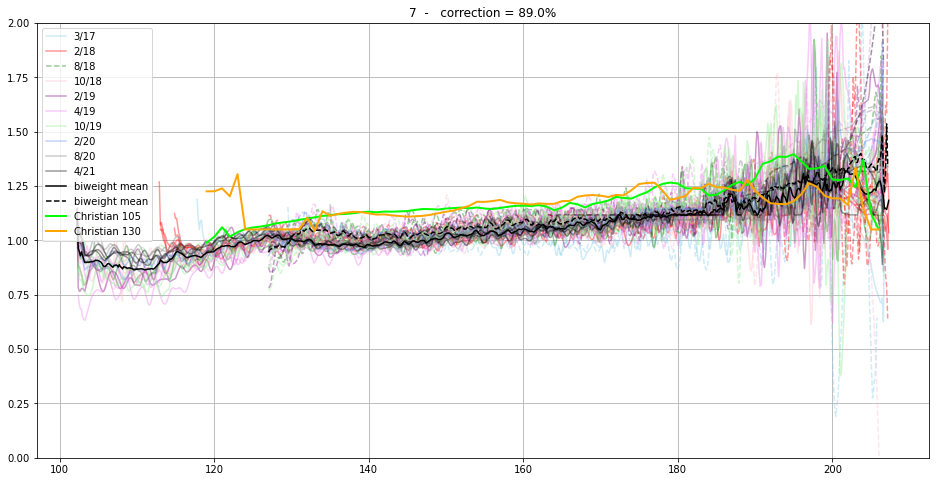

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

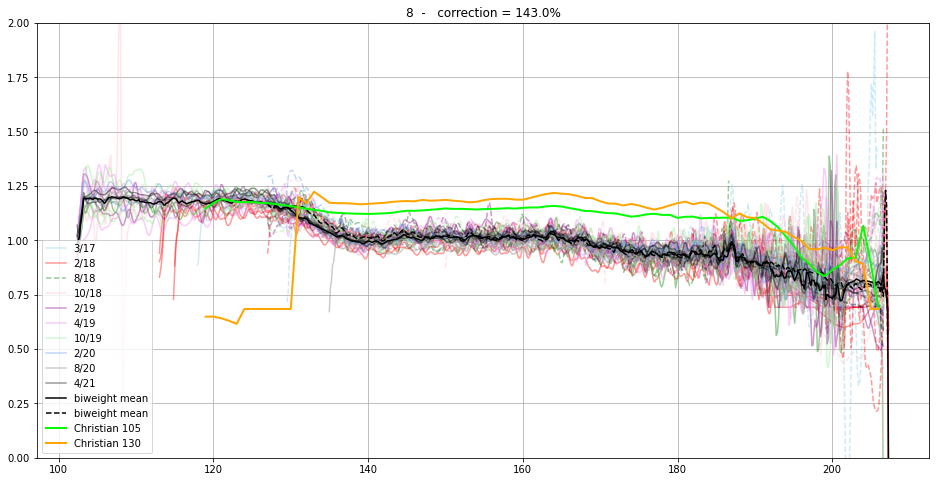

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

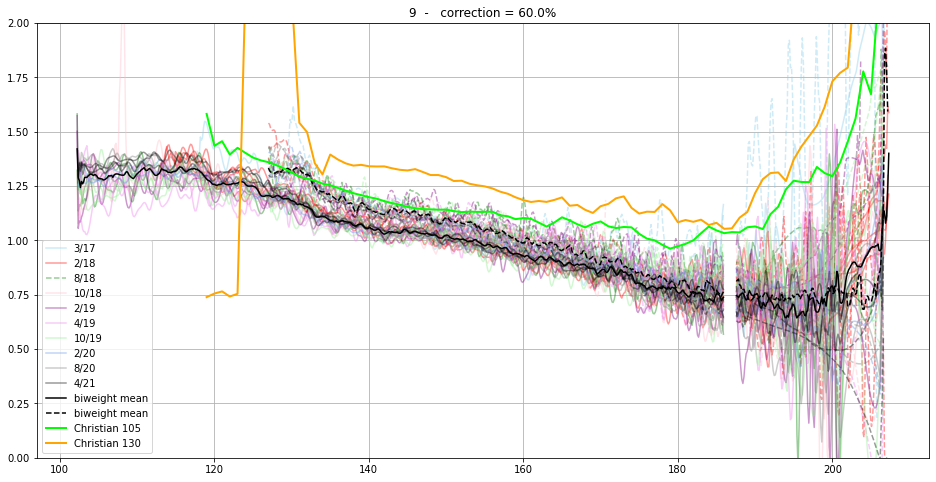

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

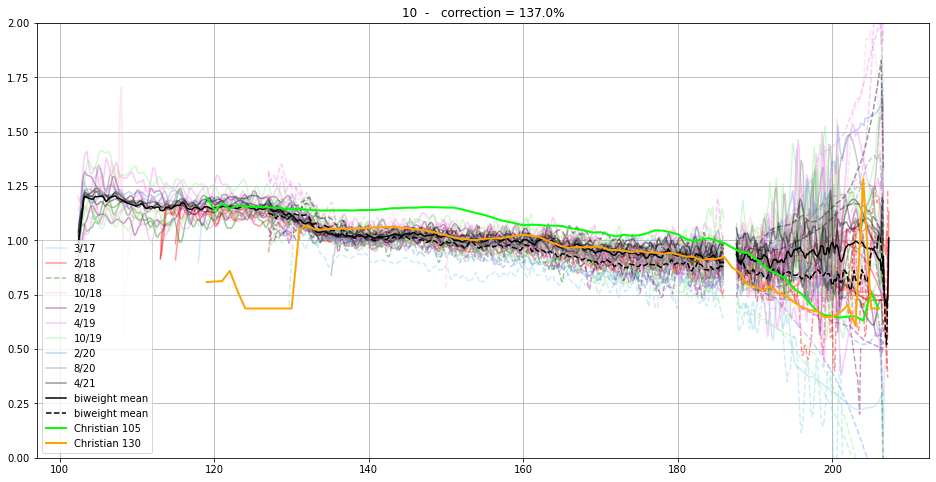

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

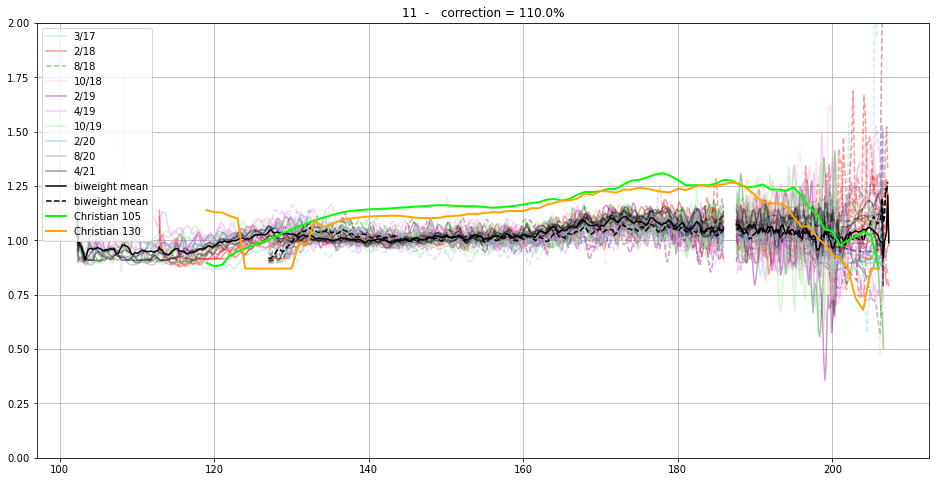

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

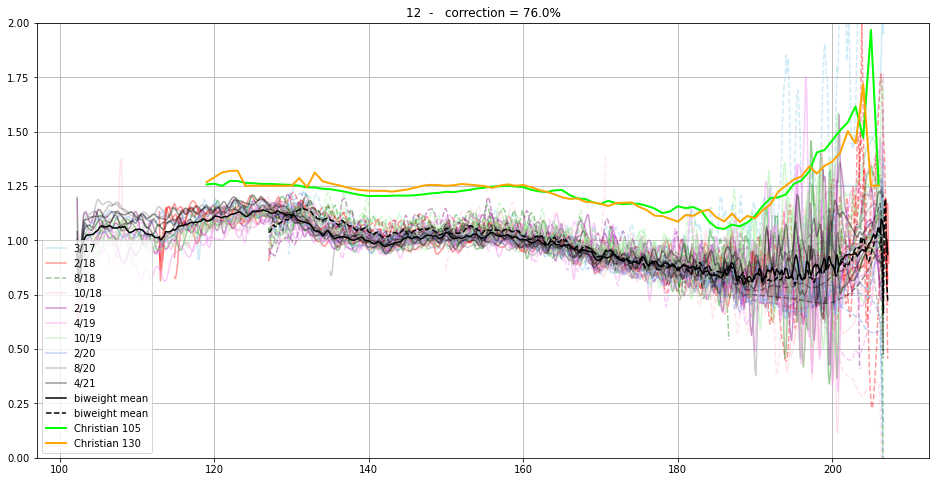

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

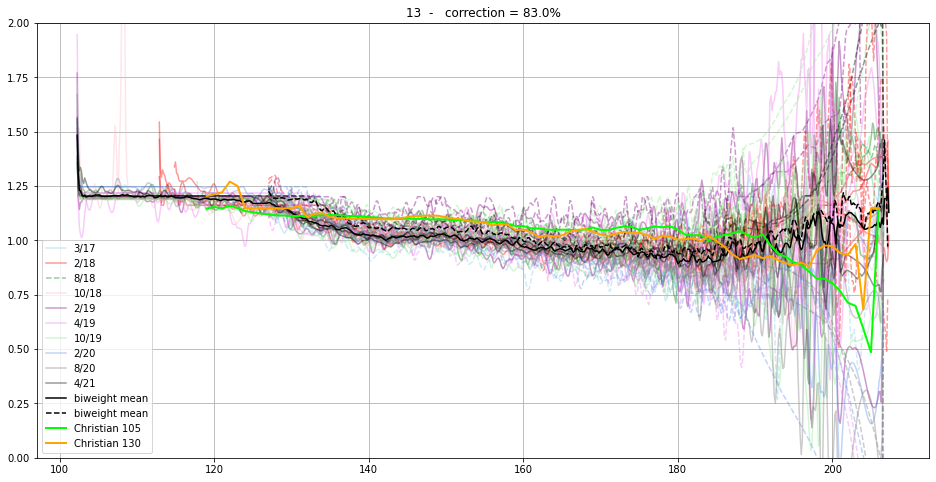

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

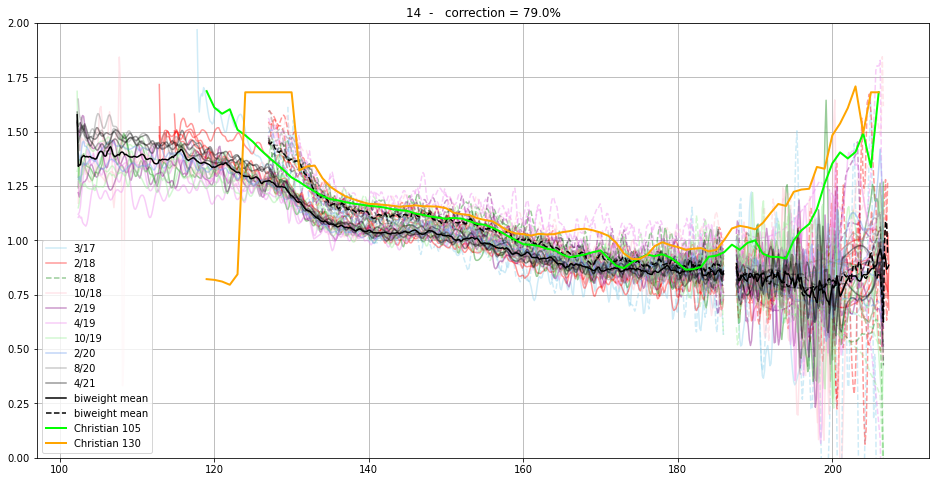

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

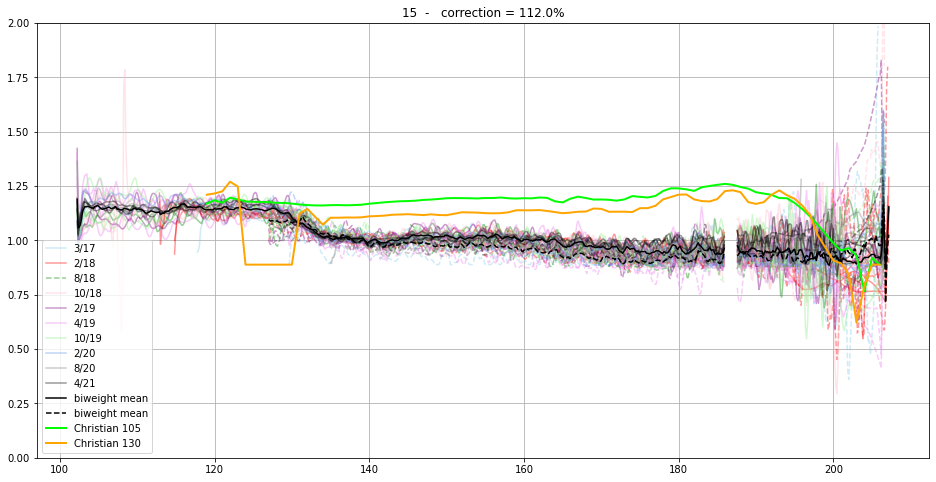

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

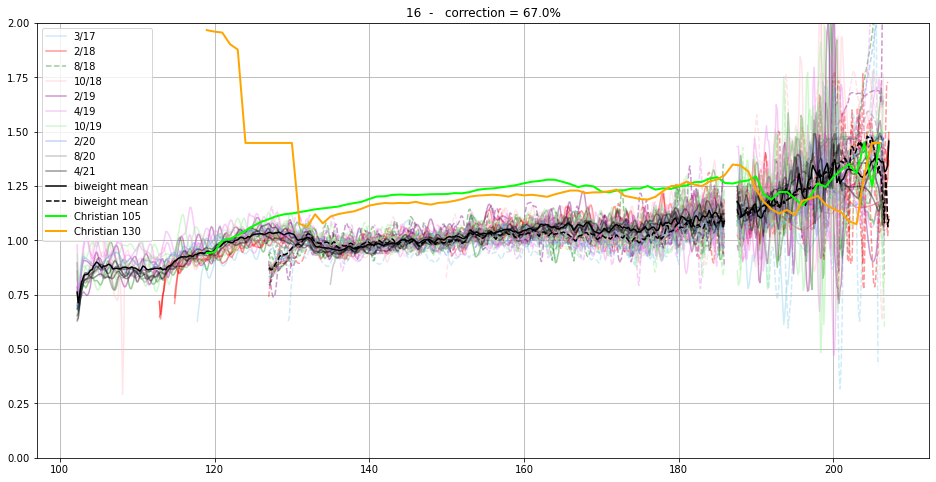

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

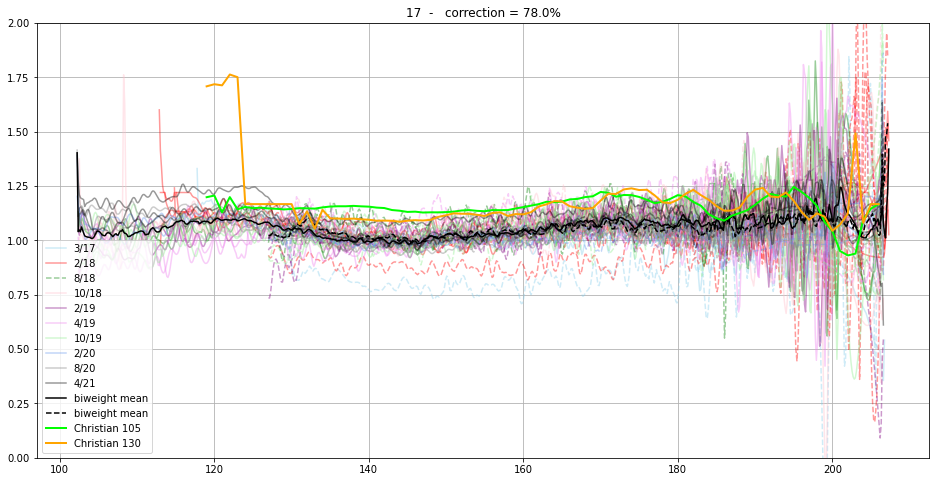

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

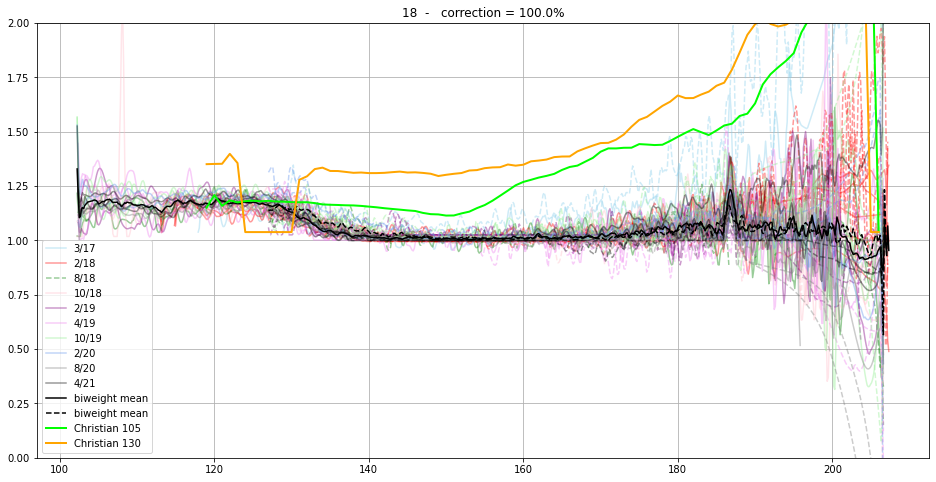

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

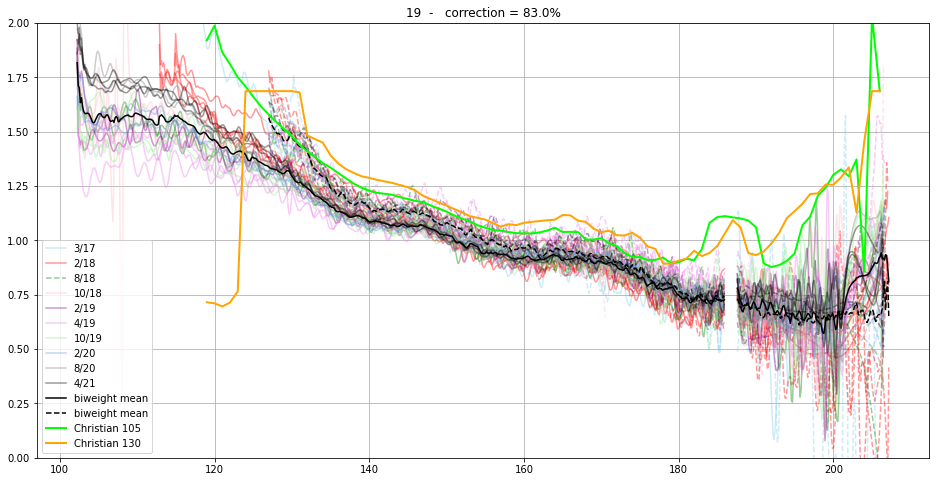

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

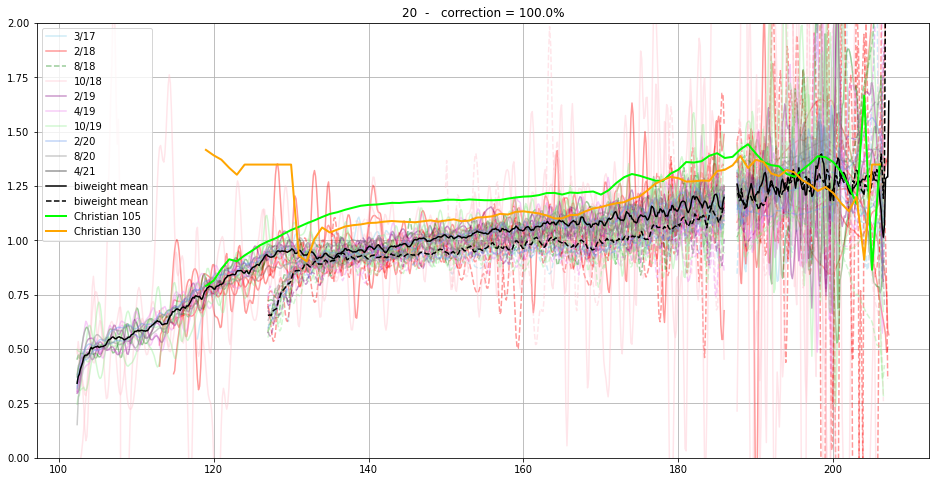

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

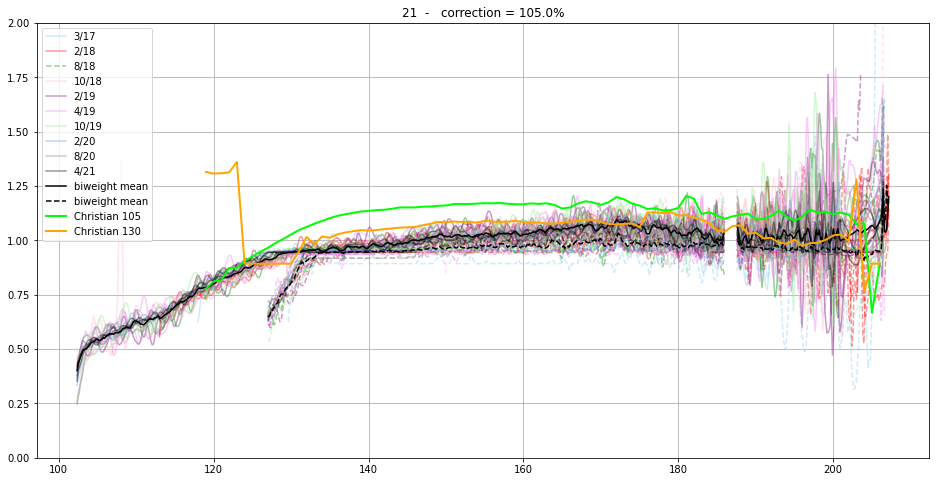

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

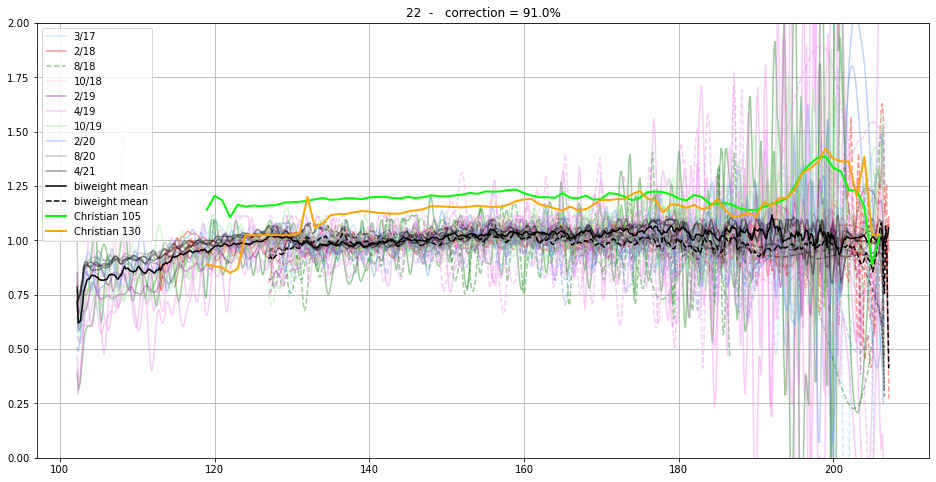

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

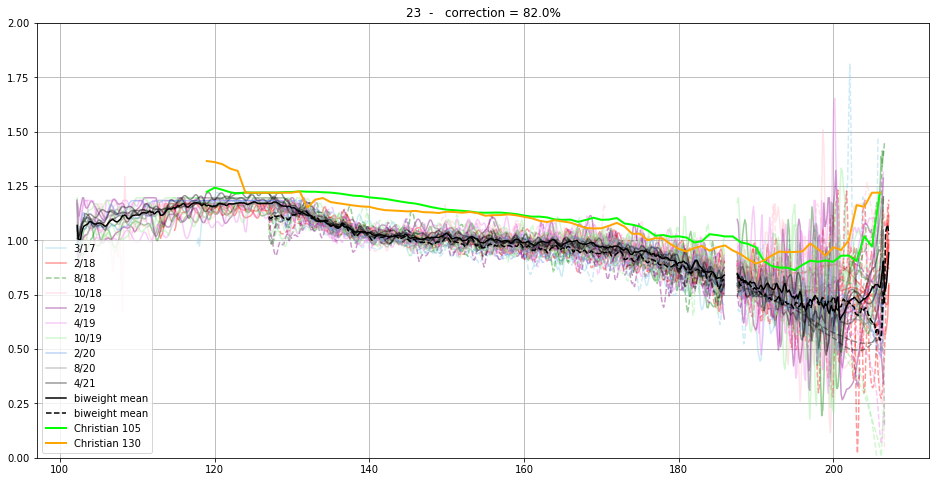

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/anaconda3/lib/python

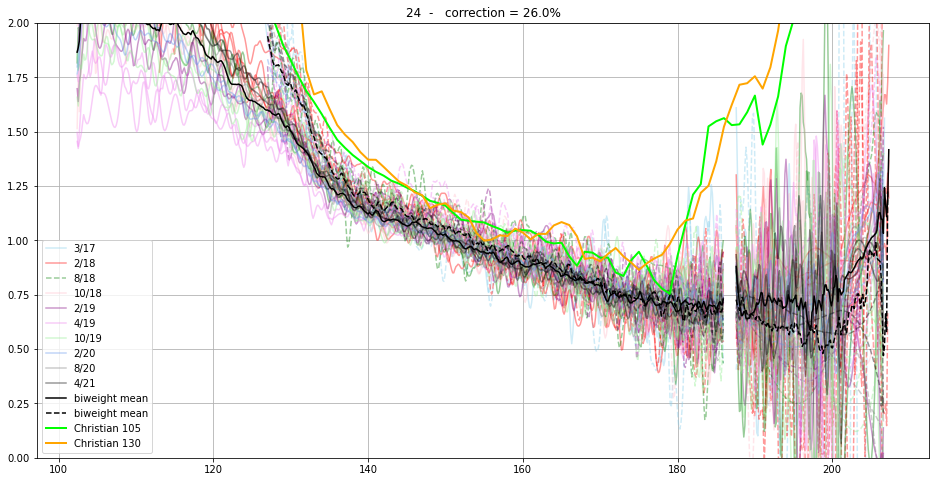

In [52]:
from fifipy.stats import biweight


def splineFitting(w, x):
    from scipy.interpolate import LSQUnivariateSpline
    idx = np.isfinite(x)
    bad = ~idx
    ww = w[idx]; xx = x[idx]
    t = ww[np.arange(1,np.size(ww)-1,np.size(ww)//10)]
    curve = LSQUnivariateSpline(ww,xx,t)
    output = curve(w)
    output[bad] = np.nan
    return output

spaxelSpectralFlatA = []
spaxelSpectralFlatB = []
#mask = [1,2,3,5,6,7,8,10,11,12,13,15,16,17,18,20,21,22,23]
mask = [1,3,5,6,7,8,10,11,12,13,15,16,17,18,21,22,23]

dold = ''
for ispax in range(25):
    fig,ax = plt.subplots(figsize=(16,8))
    specA = []
    specB = []
    for w, s, d, dic in zip(waves, spatspectra, dates, dichroics):
        meds,sigs = biweight(s[mask,:], axis = 0)
        for ud, si, c in zip(udates, ssi, colors):
            if d == ud:
                color = c
                ss = si
        if dic == 105:
            line = '-'
        else:
            line = '--'
        if dic == 105:
            specA.append(s[ispax,:]/meds/ss[ispax])
        else:
            specB.append(s[ispax,:]/meds/ss[ispax])
        if d != dold:
            ax.plot(w, s[ispax,:]/meds/ss[ispax], line, label = d, color=color,alpha=0.4)
            dold = d
        else:
            ax.plot(w, s[ispax,:]/meds/ss[ispax], line, color=color,alpha=0.4) 
    specA = np.array(specA)
    ssf,sigs = biweight(specA, axis=0)
    # Should we smooth ?
    #ssf = splineFitting(w, ssf)
    ax.plot(w, ssf, color='black',label='biweight mean')
    spaxelSpectralFlatA.append(ssf)
    specB = np.array(specB)
    ssf,sigs = biweight(specB, axis=0)
    # Should we smooth ?
    #ssf = splineFitting(w, ssf)
    ax.plot(w, ssf, '--', color='black',label='biweight mean')
    spaxelSpectralFlatB.append(ssf)

    ax.plot(wch, ff105[:,ispax]/ssi[0][ispax],color='lime',label='Christian 105',linewidth=2)
    ax.plot(wch, ff130[:,ispax]/ssi[0][ispax],color='orange',label='Christian 130',linewidth=2)
    
    ax.legend()
    ax.set_title(str(ispax) + '  -   correction = ' + str(ss[ispax]*100//1) + '%')
    ax.set_ylim([0,2])
    ax.grid()
    plt.show()


## Step 3

Correcting the original spectra with spaxel spectral flats, recompute median spectra per spaxel,
and compute the spectral flats per spexel.

At the end, we can merge the two components or leave them separated.
In the future, we should have the possibility of adding a 5x5 real spatial flat 
which can be derived from sky or moon measurements.

In [53]:
# Copy the spectra
corrSpectra = spectra.copy()

# Apply the corrections spaxelSpectralFlat
w = waves[0]
for s, d in zip(corrSpectra, dichroics):
    # Choice of flat
    if d == 105:
        sflat = spaxelSpectralFlatA
    else:
        sflat = spaxelSpectralFlatB
    # Interpolation & flat
    for i, sf in enumerate(sflat):
        for j in range(16):
            s[i*16+j,:] /= sf

# Recompute spat spectra using the corrected spectra
spatspectra = []
for spectrum in corrSpectra:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra.append(spatspectrum)
spatspectra = np.array(spatspectra)

/Users/dfadda/Python/fifipy/fifipy/spectra.py:88: RuntimeWarning: Mean of empty slice
  mspec = np.nanmean(spec[m],axis=0)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1114: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input)
/Users/dfadda/Python/fifipy/fifipy/spectra.py:81: RuntimeWarning: Mean of empty slice
  d.append(np.nanmean(np.array(r)))


In [54]:
Test=False

In [55]:
from fifipy.stats import biweightLocation
# Check on spatspectra and update si (spatial flats)
w = waves[0]
for ispax in range(25):
    med = []
    for ss, date in zip(spatspectra, dates):
        smed = biweightLocation(ss, axis=0)
        for ud, ssi_ in zip(udates, ssi):
            if date == ud:
                si = ssi_
        if (date == '4/21') & (ispax in [2,20]):
            med.append(np.nan)
        else:
            med.append(biweightLocation(ss[ispax,:]/smed/si[ispax]))
    med = np.array(med)
    if Test:
        print('Spaxel ', ispax+1)
    for ud, si in zip(udates, ssi):
        if (ud == '4/21'):
            if np.sum(np.isfinite(med[dates == ud])) == 0:
                mi = 1
            else:
                mi = biweightLocation(med[dates == ud])
        else:
            mi = biweightLocation(med[dates == ud])
        si[ispax] *= mi
        if Test: 
            print(mi)
    if Test:
        fig,ax = plt.subplots(figsize=(16,8))
        for ss, date in zip(spatspectra, dates):
            smed = biweightLocation(ss, axis=0)
            for ud, ssi_ in zip(udates, ssi):
                if date == ud:
                    si = ssi_
            ax.plot(w, ss[ispax,:]/smed/si[ispax])
        ax.set_title('spaxel '+ str(ispax))
        ax.grid()
        ax.set_ylim(0,2)
        plt.show()

In [56]:
Test = True

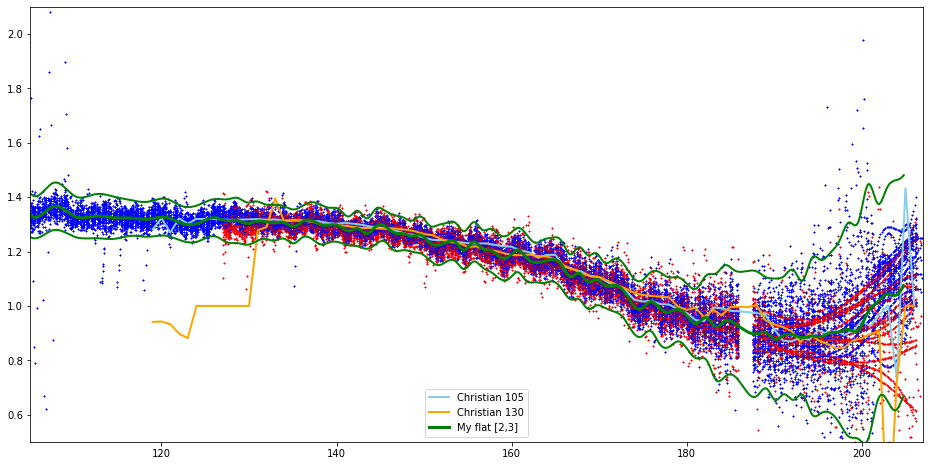

In [58]:
# TEST
%matplotlib inline
from fifipy.spectra import computeFlatRed
if Test:
    wdario = np.arange(105,205,0.2)
    fdario = np.ones((np.size(wdario),25,16))
    ispax = 1
    ispex = 2
    fig,ax = plt.subplots(figsize=(16,8))
    w = waves[0]
    for i in range(len(dichroics)):
        flats = computeFlatRed(waves,corrSpectra,spatspectra,ispax,ispex,delta=1.2)
        for s,ss,d in zip(corrSpectra, spatspectra, dichroics):
            if d == 105:
                color = 'blue'
            else:
                color = 'red'
            ax.plot(w,s[ispax*16+ispex]/ss[ispax],'.',markersize=0.2,color=color,linewidth=0.5)
    ax.plot(wch, f105[:,ispax,ispex],color='skyblue',label='Christian 105',linewidth=2)
    ax.plot(wch, f130[:,ispax,ispex],color='orange',label='Christian 130',linewidth=2)
    if flats is not None:
        flat, eflat = flats
        f = flat(wdario)
        ef = eflat(wdario)
        ax.plot(wdario,f,color='green',label='My flat ['+str(ispax+1)+','+str(ispex+1)+']',linewidth=3.)
        ax.plot(wdario,f+3*ef,color='green',linewidth=2.)
        ax.plot(wdario,f-3*ef,color='green',linewidth=2.)
        fdario[:,ispax,ispex] = flat(wdario)
    ax.set_xlim([105,207])
    ax.set_ylim([0.5,2.1])
    ax.legend()
    plt.show()

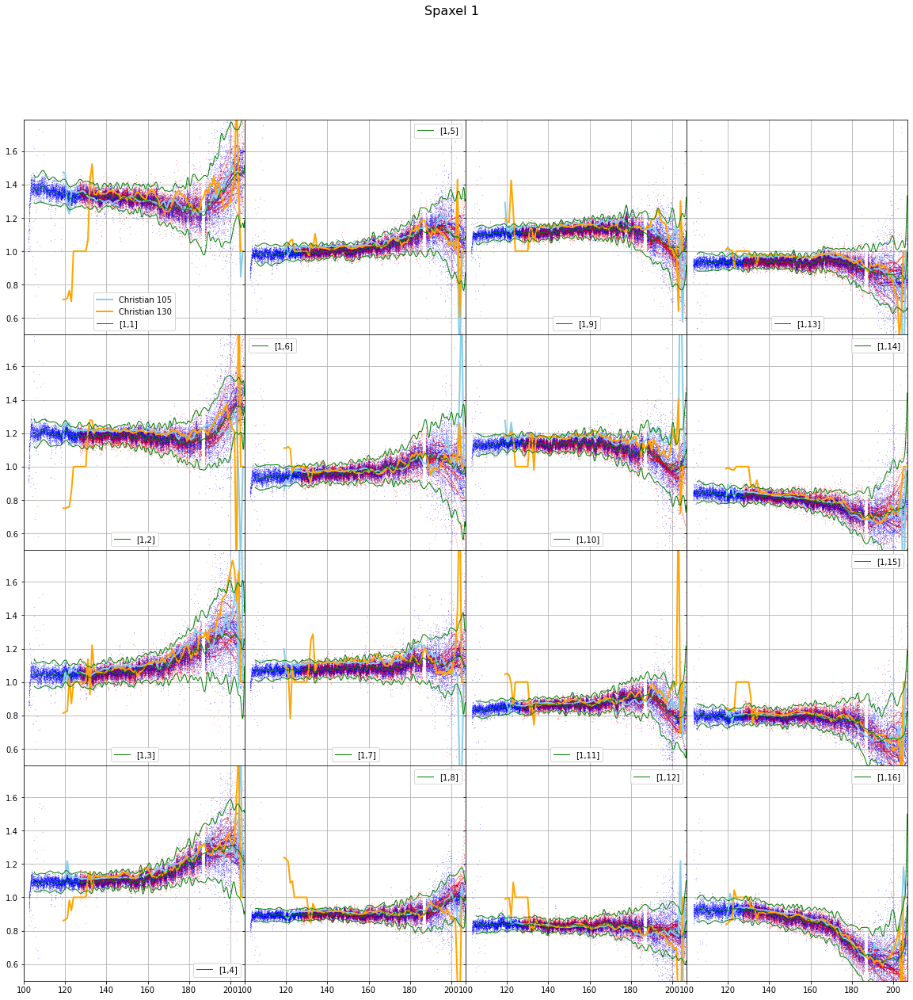

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
No handles with labels found to put in legend.


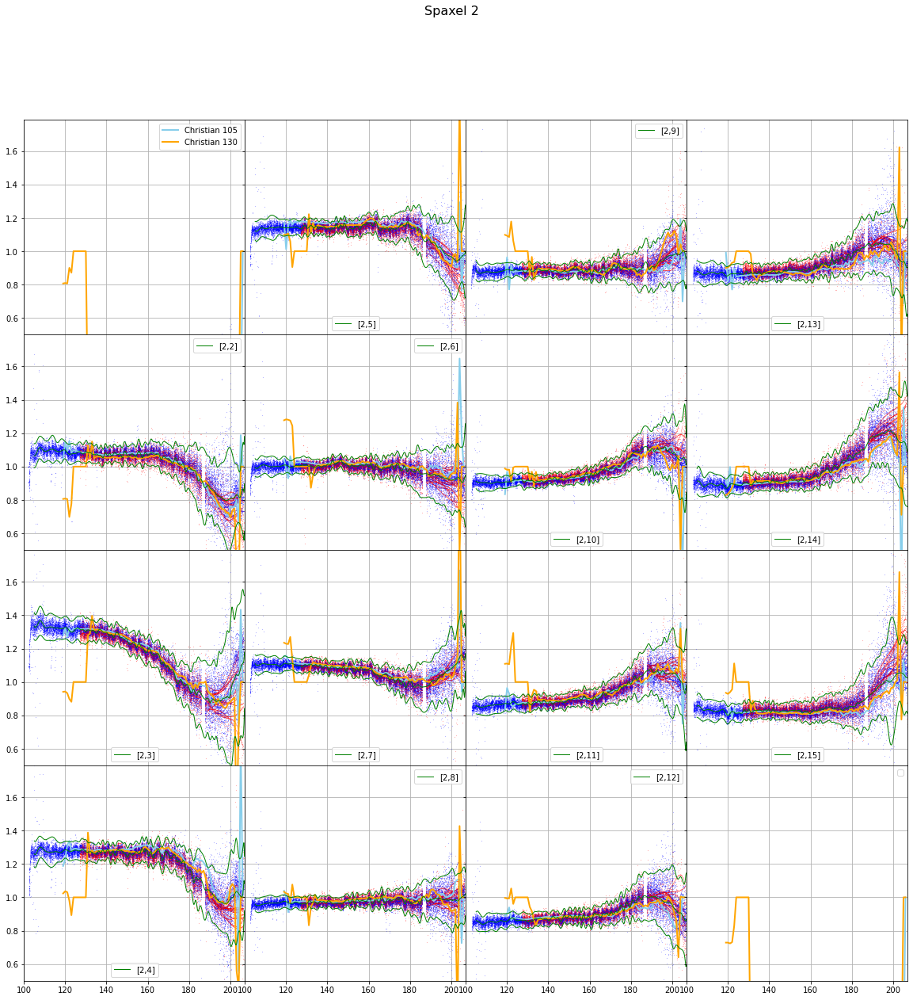

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anacon

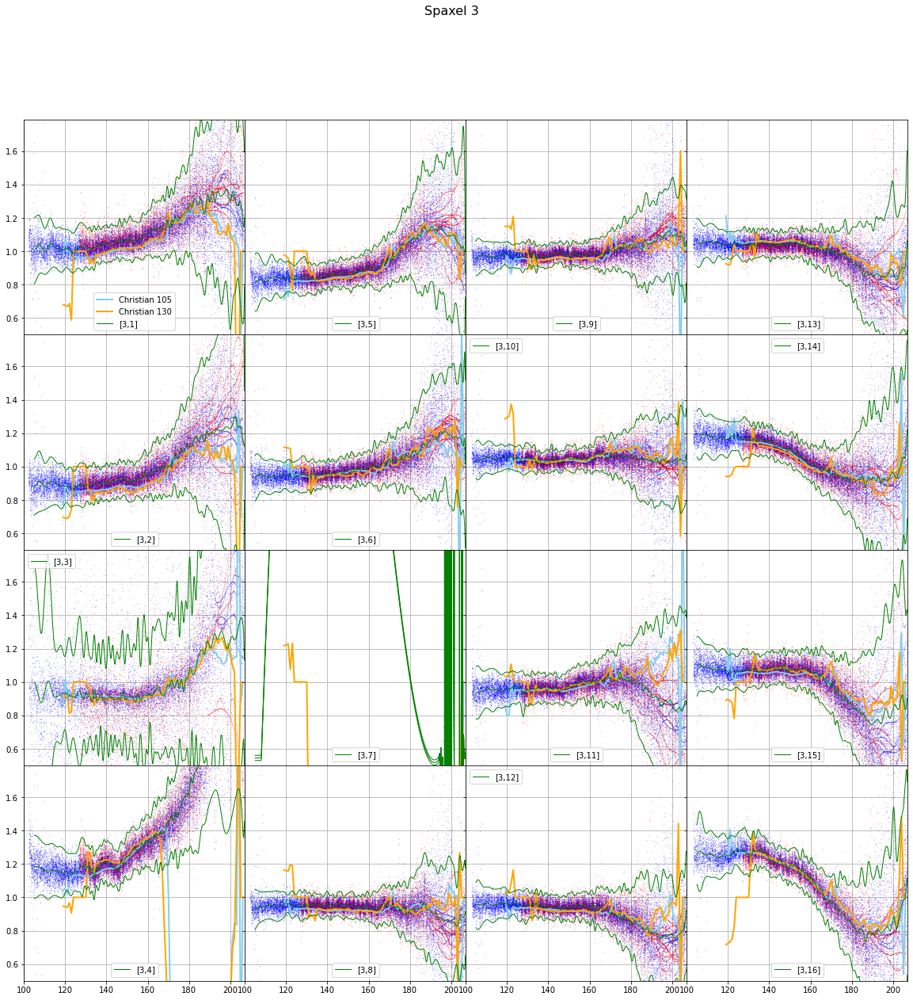

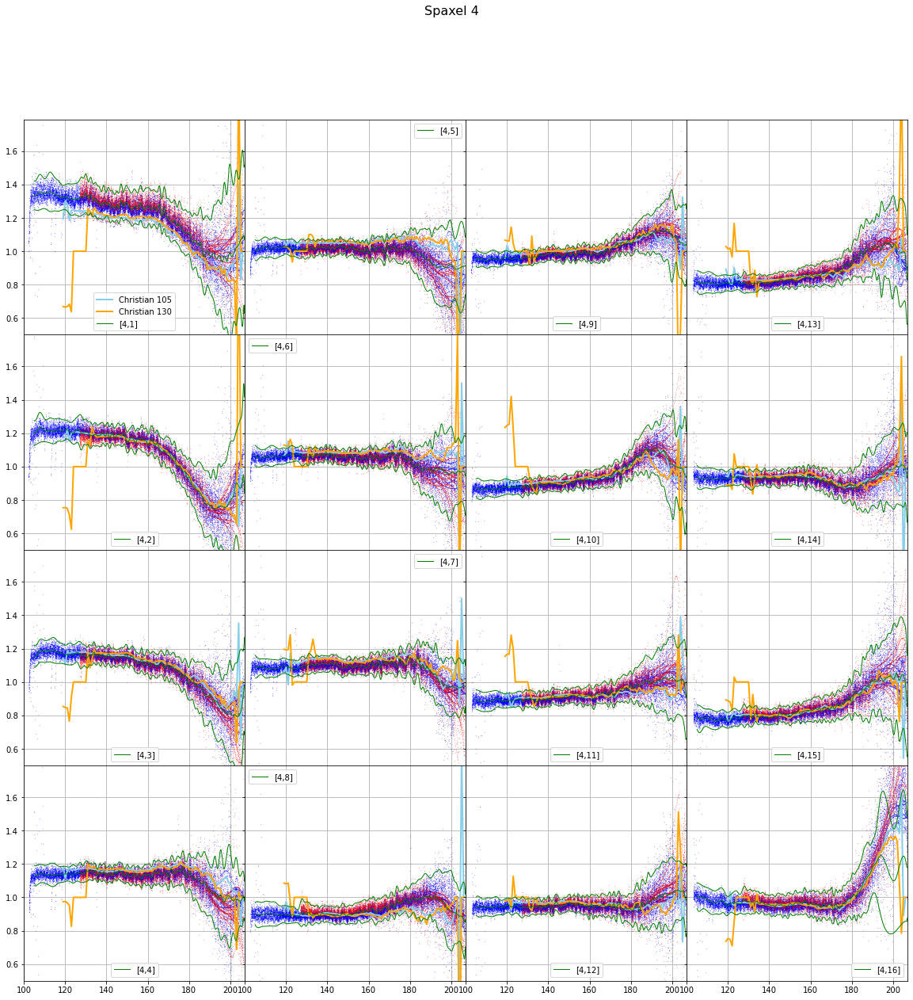

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)


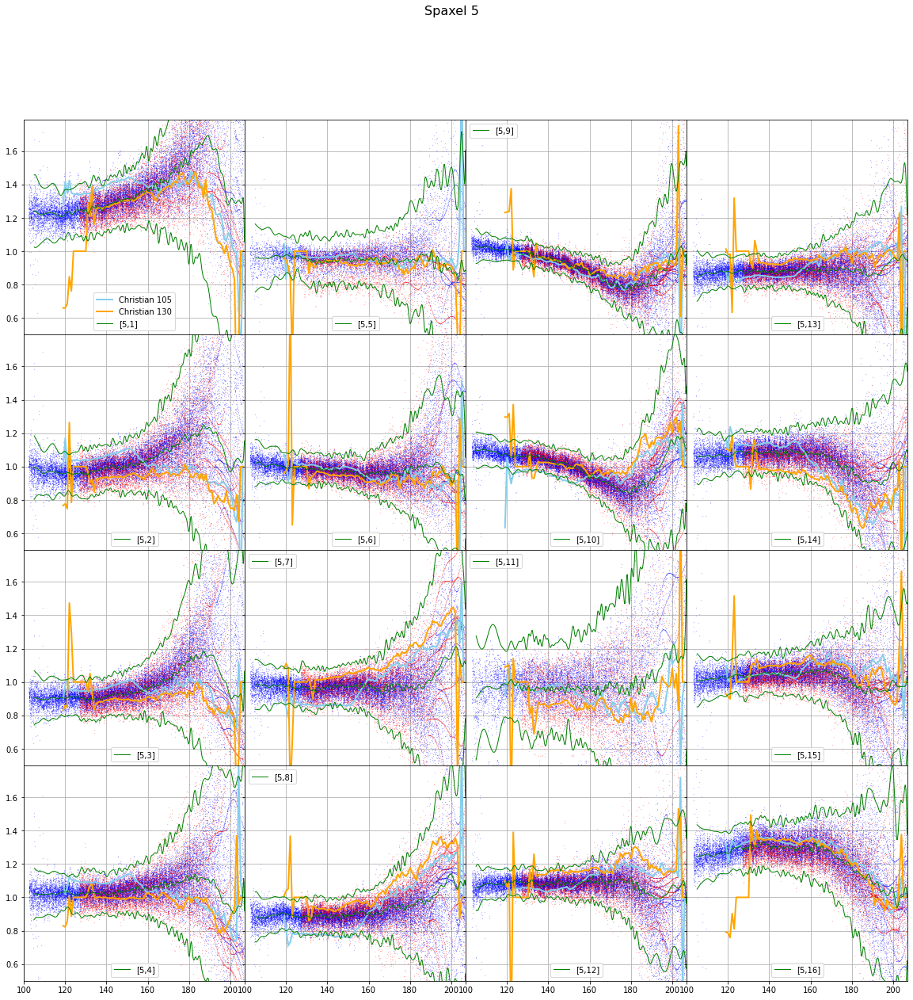

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)


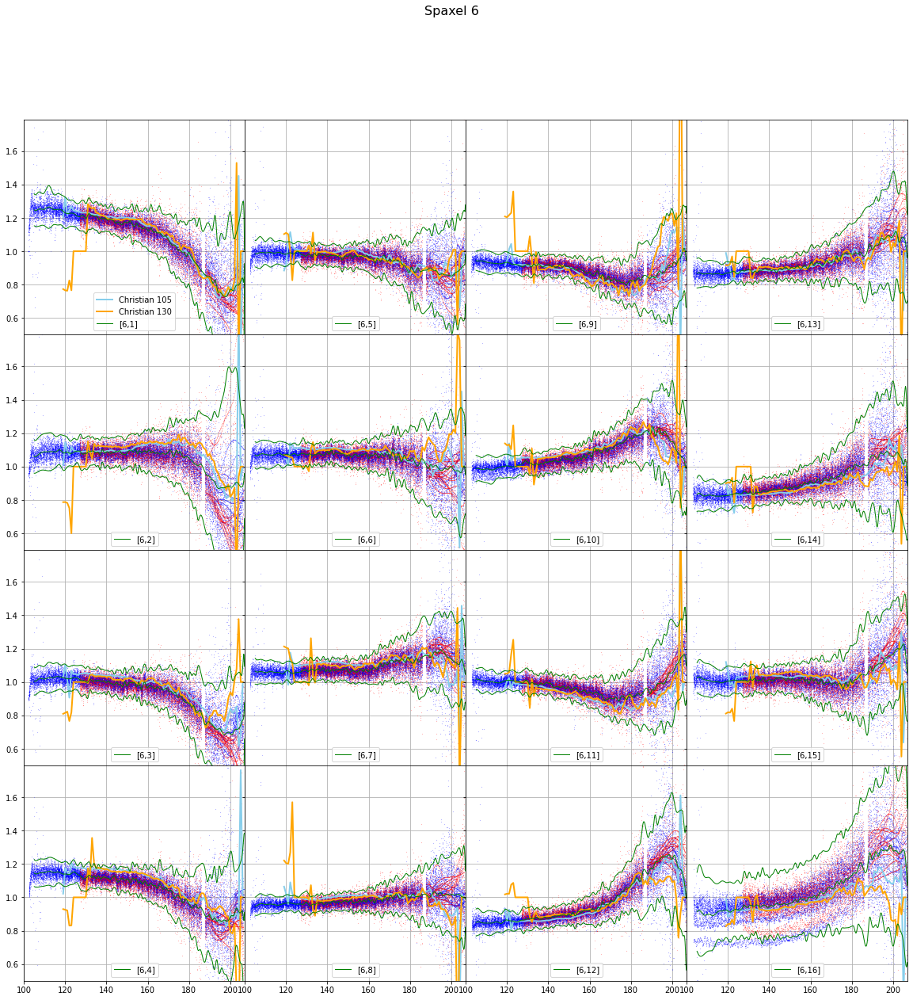

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)


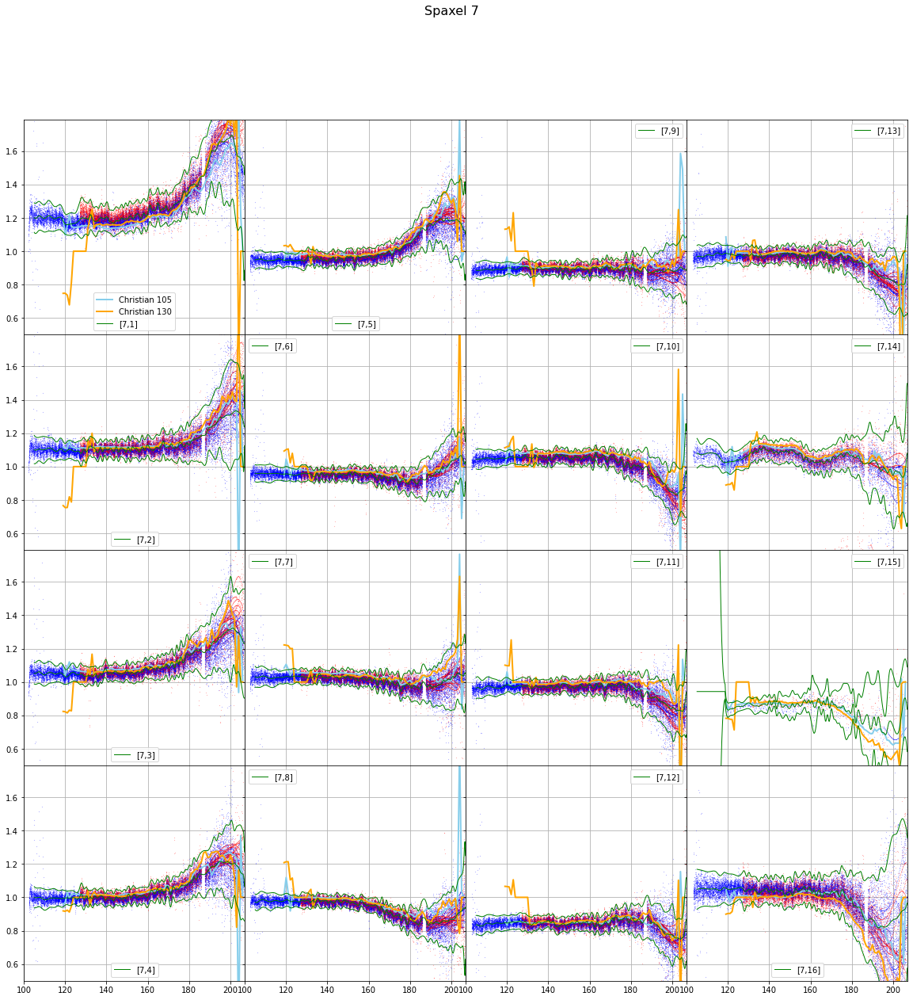

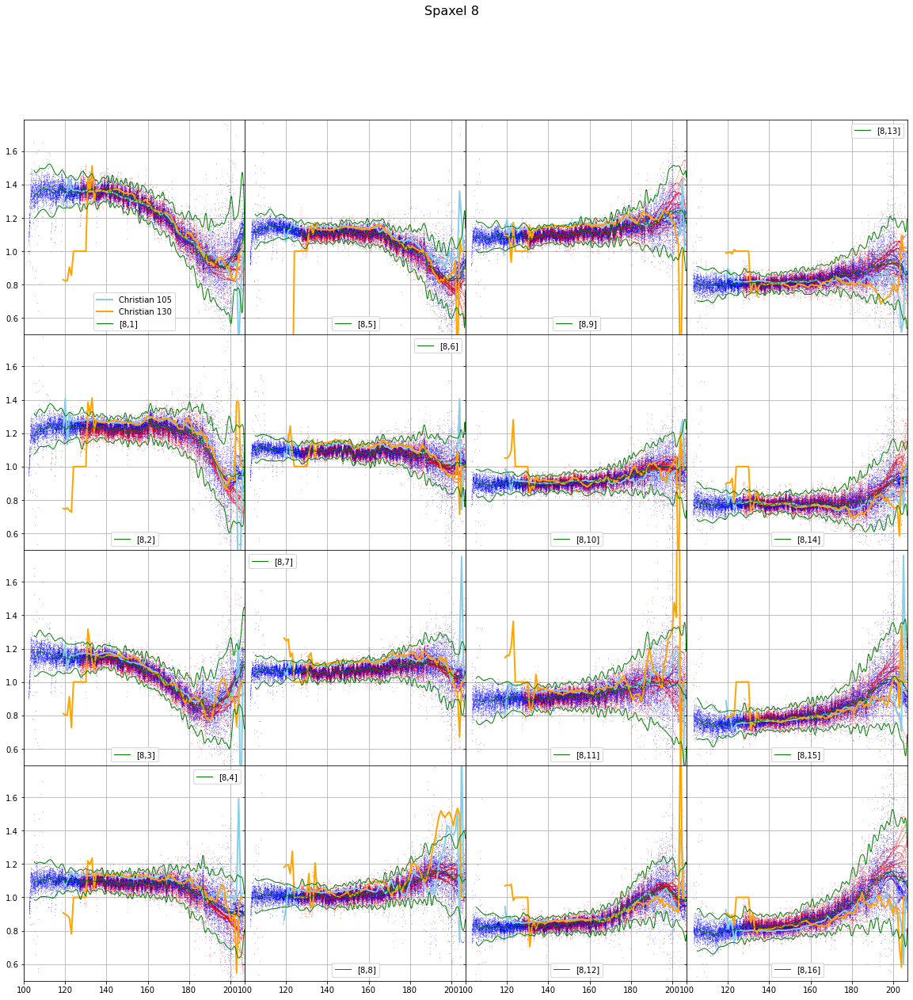

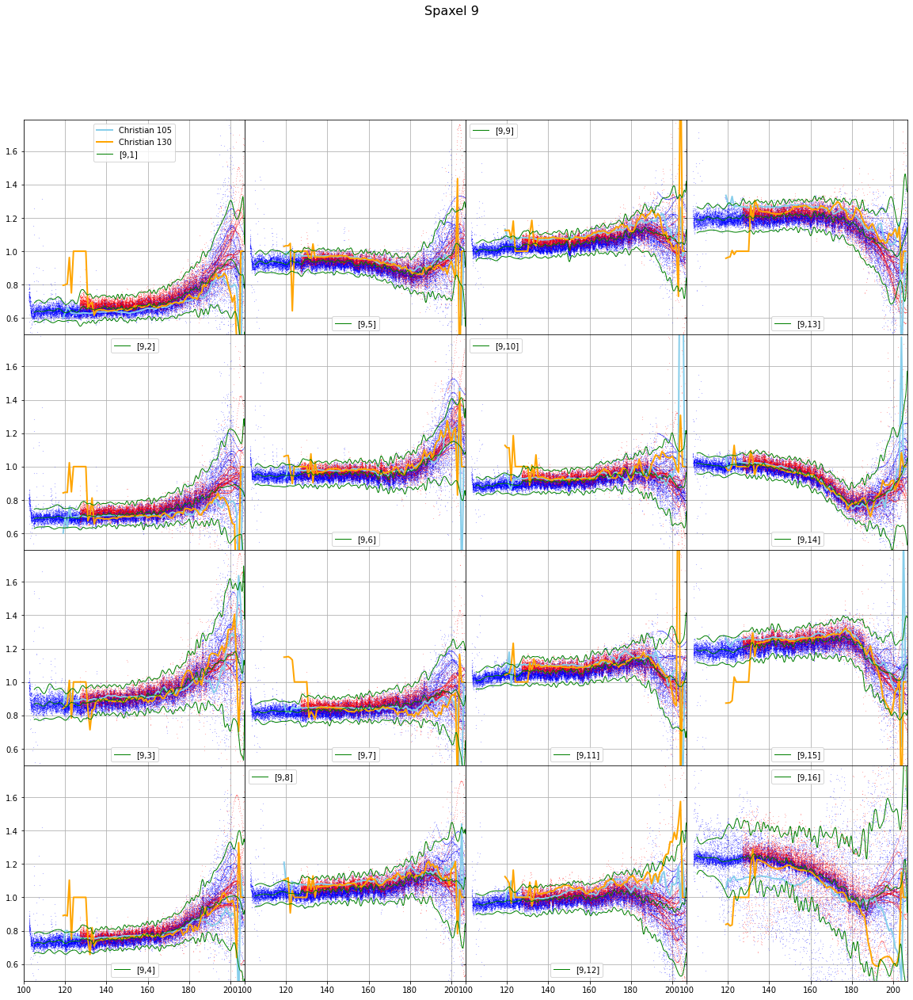

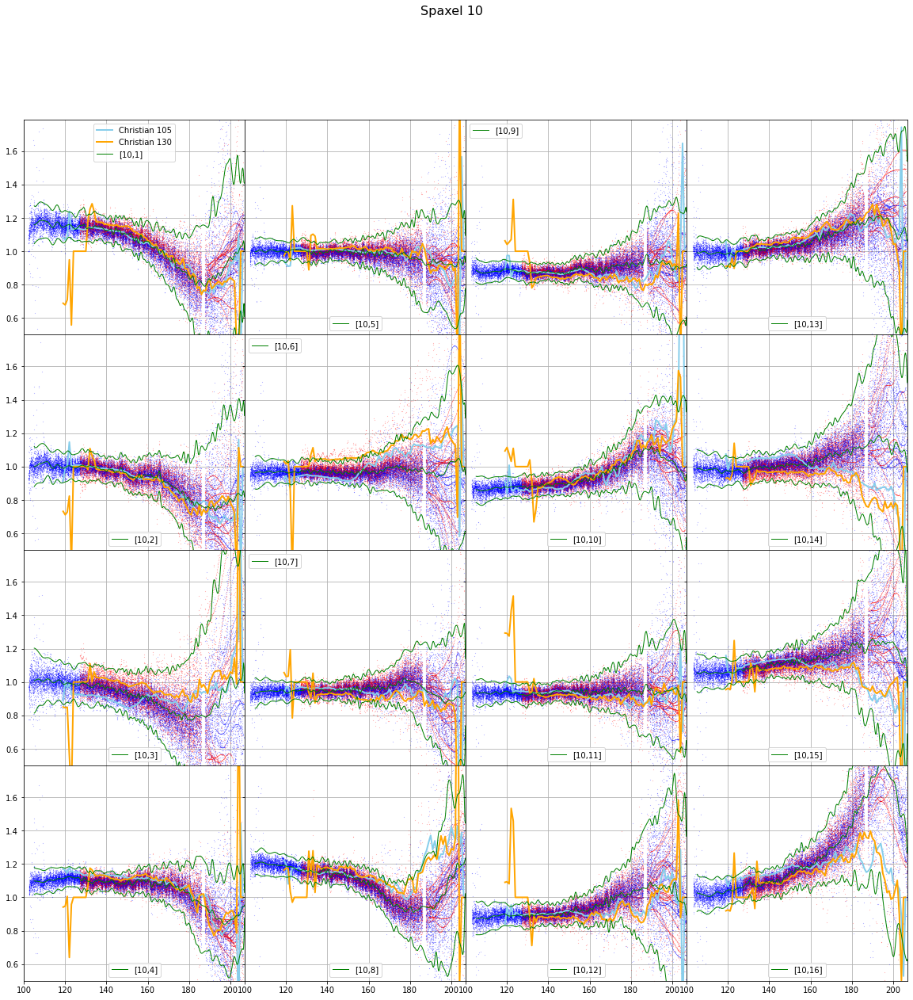

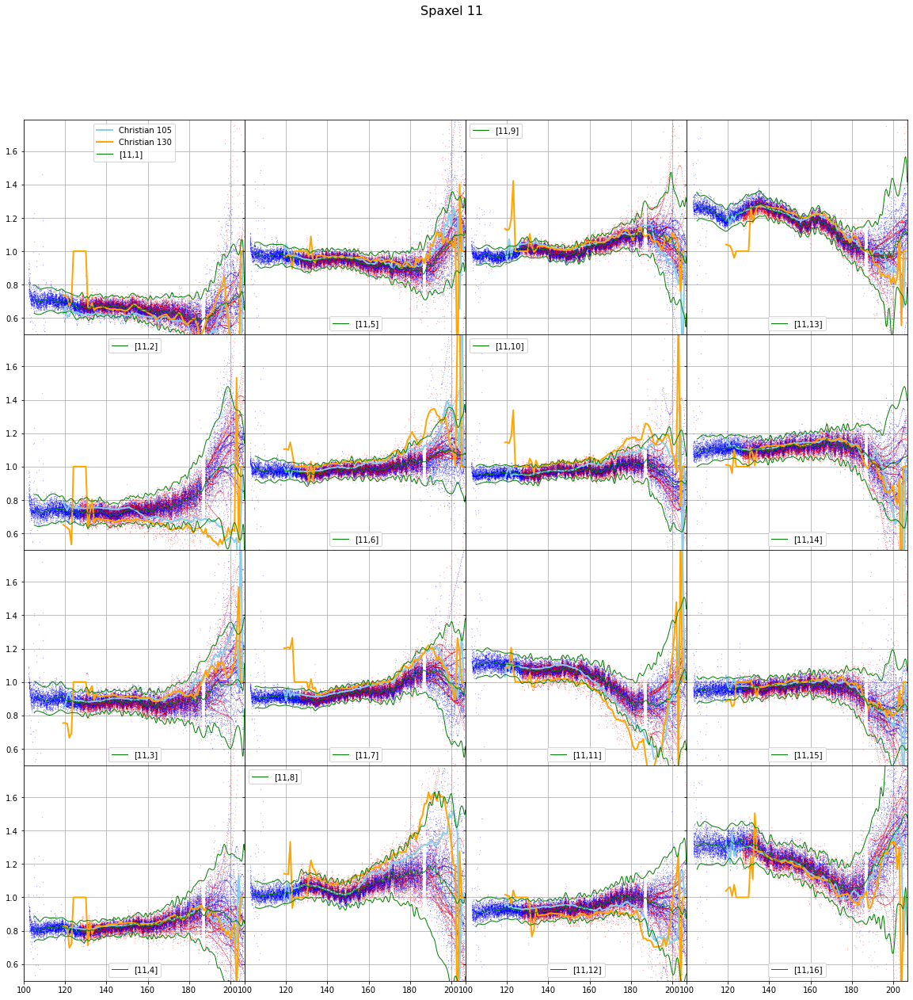

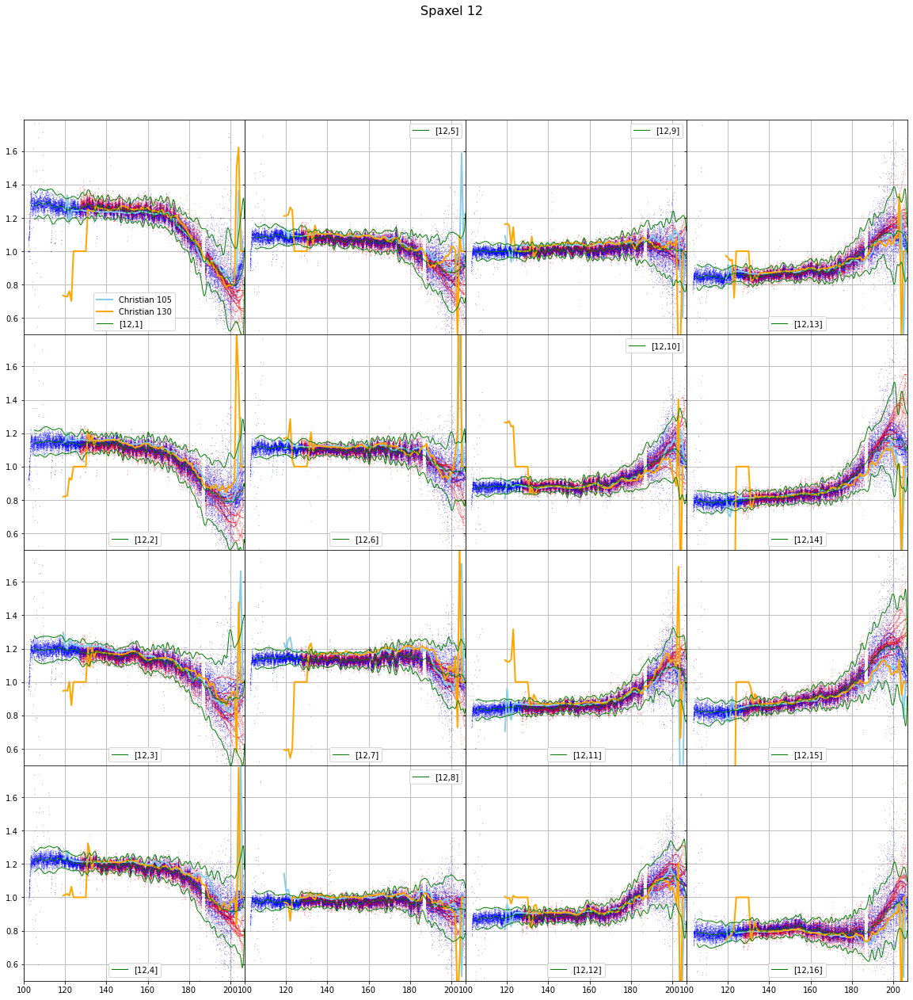

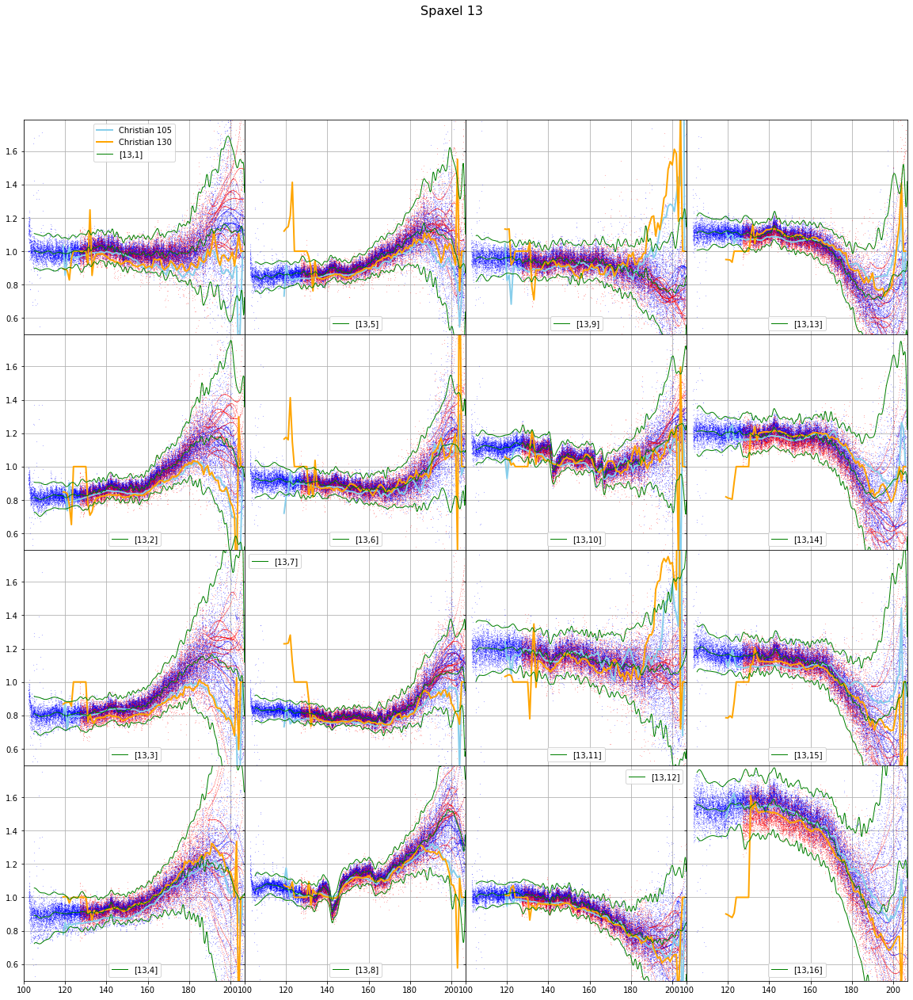

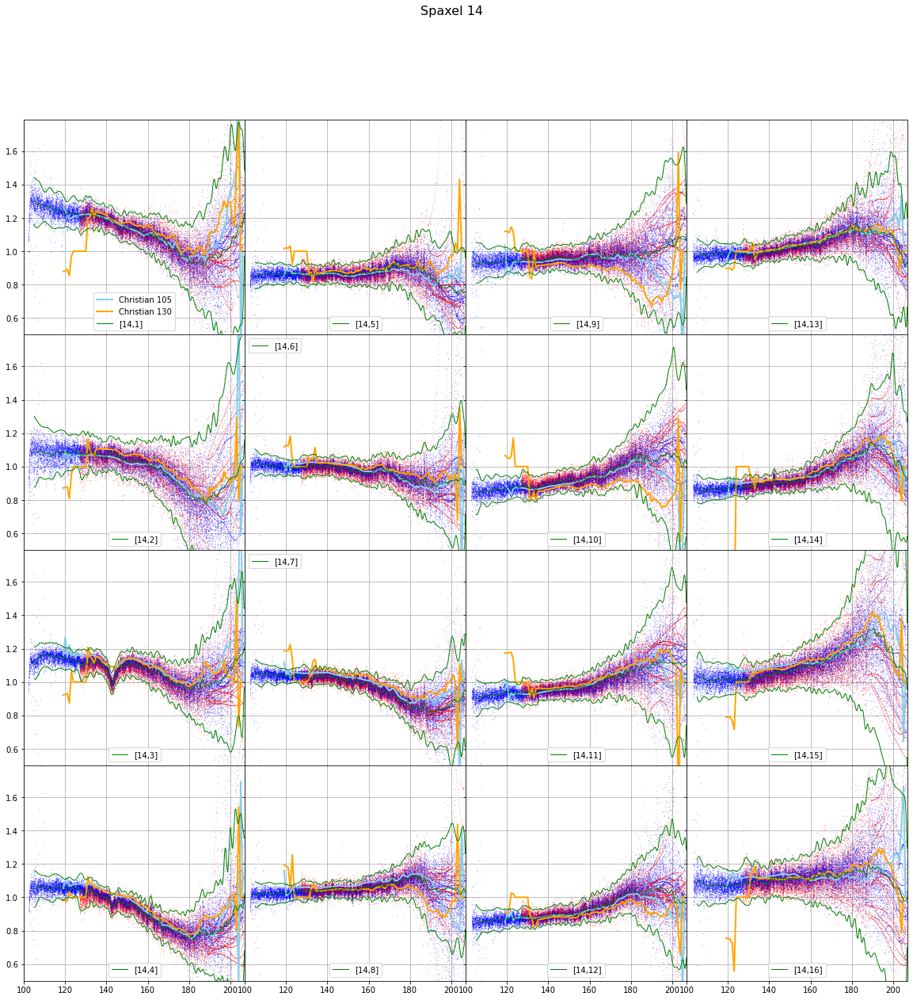

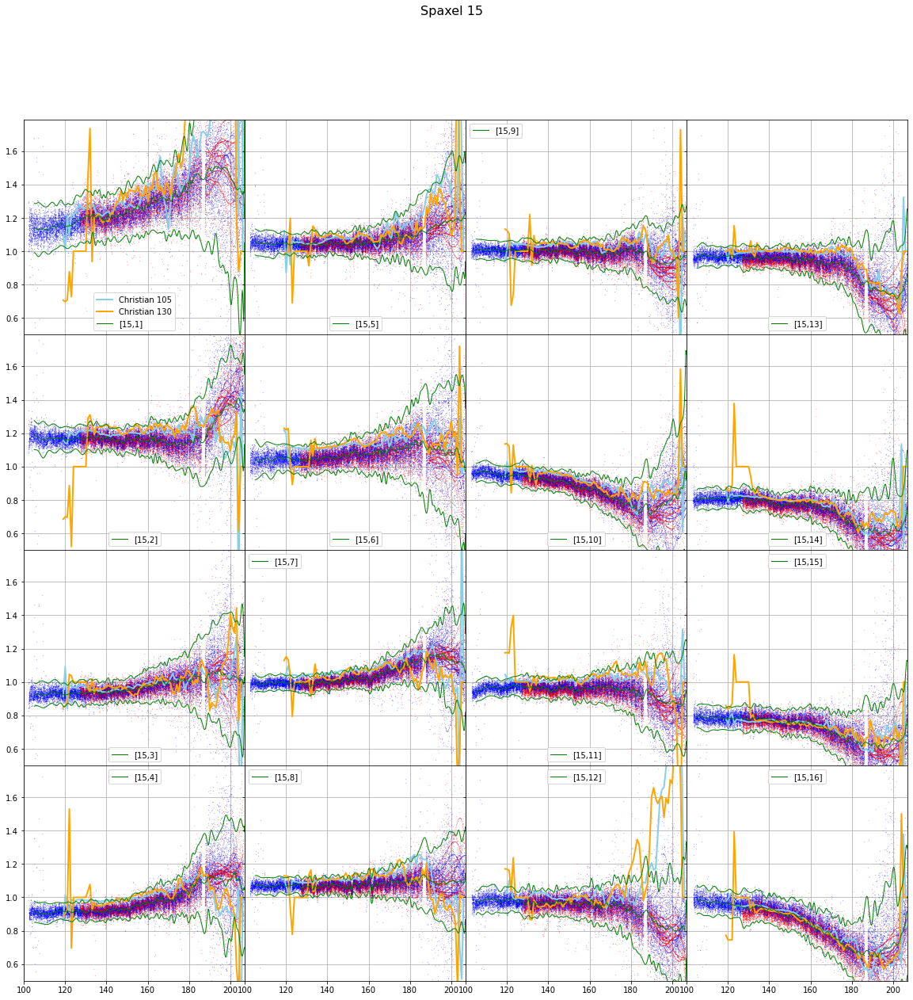

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
No handles with labels found to put in legend.
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d,

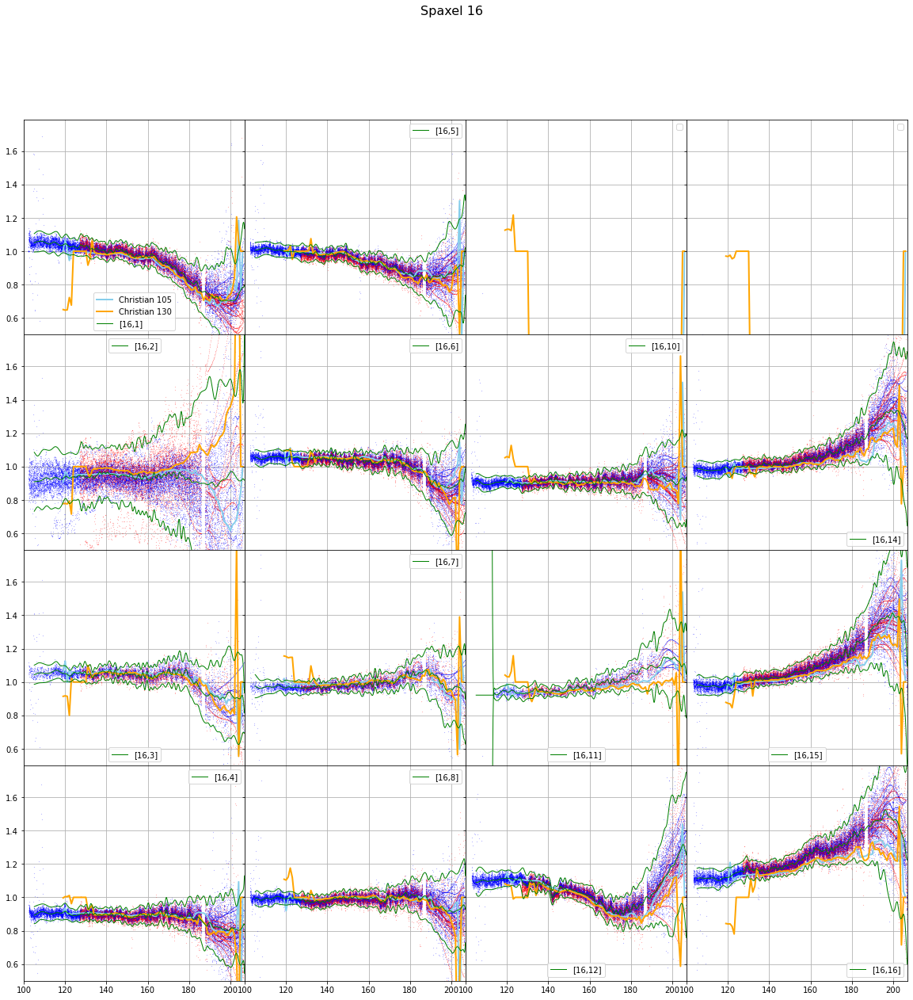

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
No handles with labels found to put in legend.


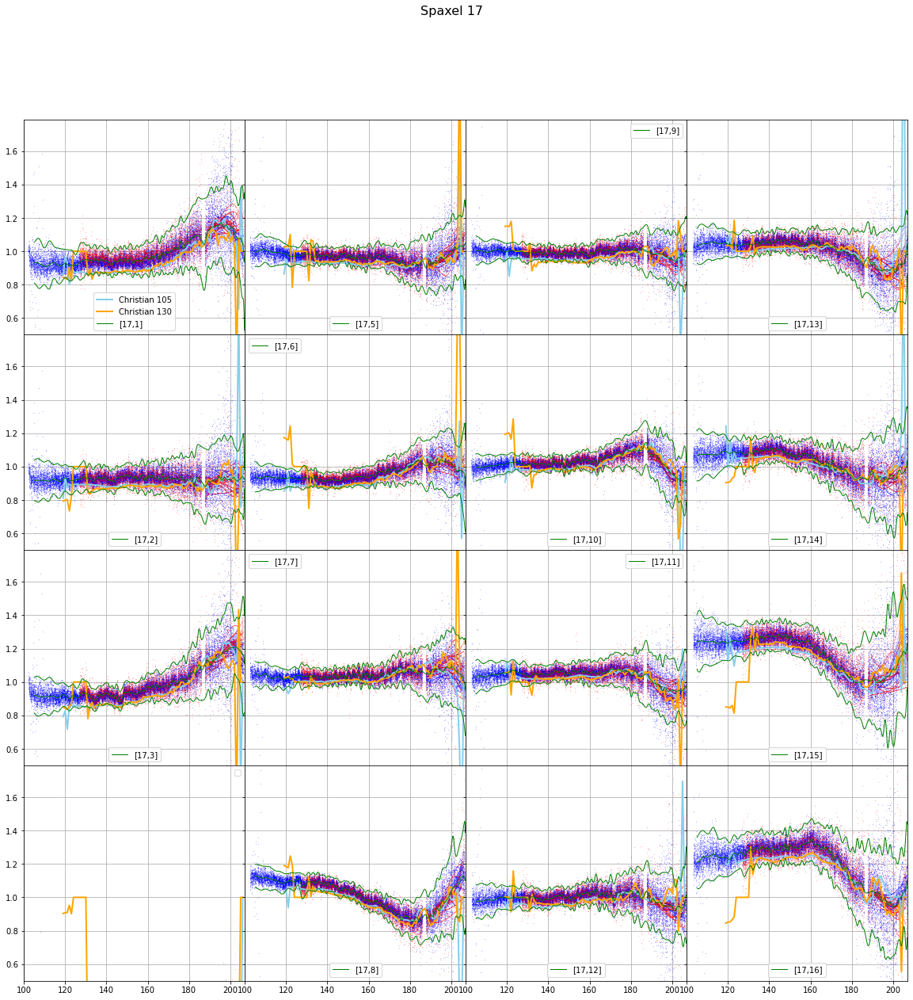

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
No handles with labels found to put in legend.
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)


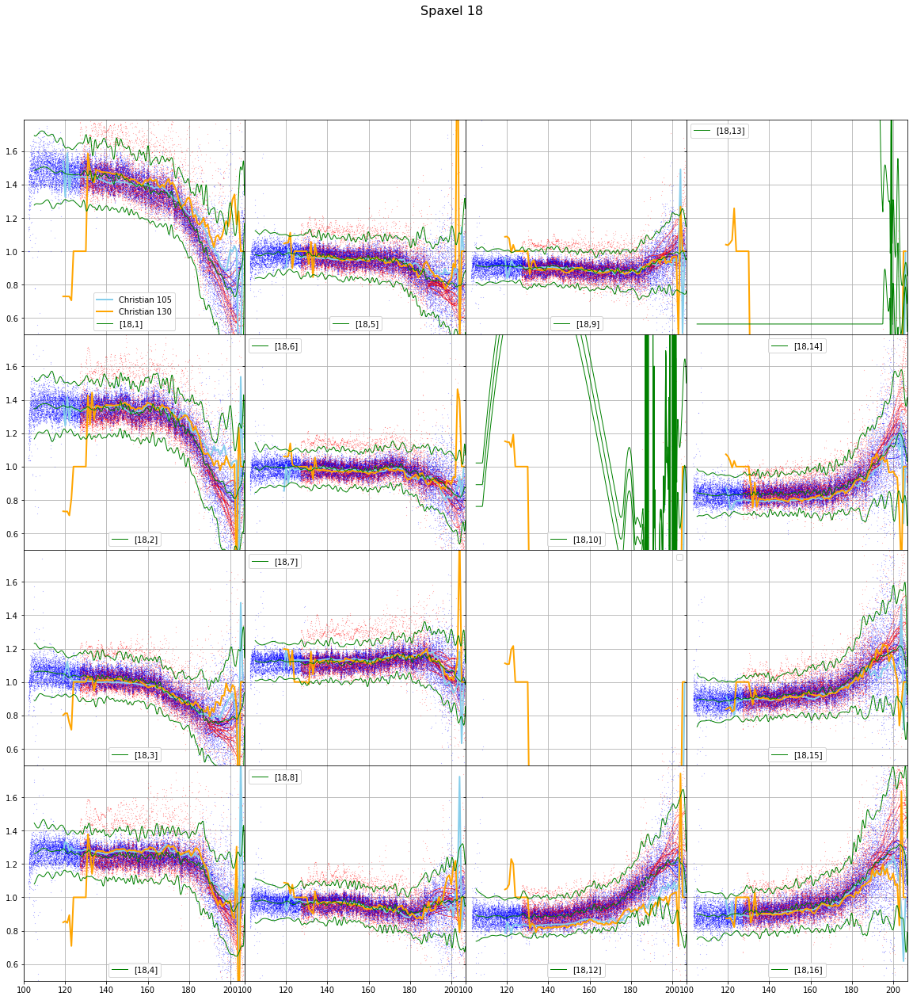

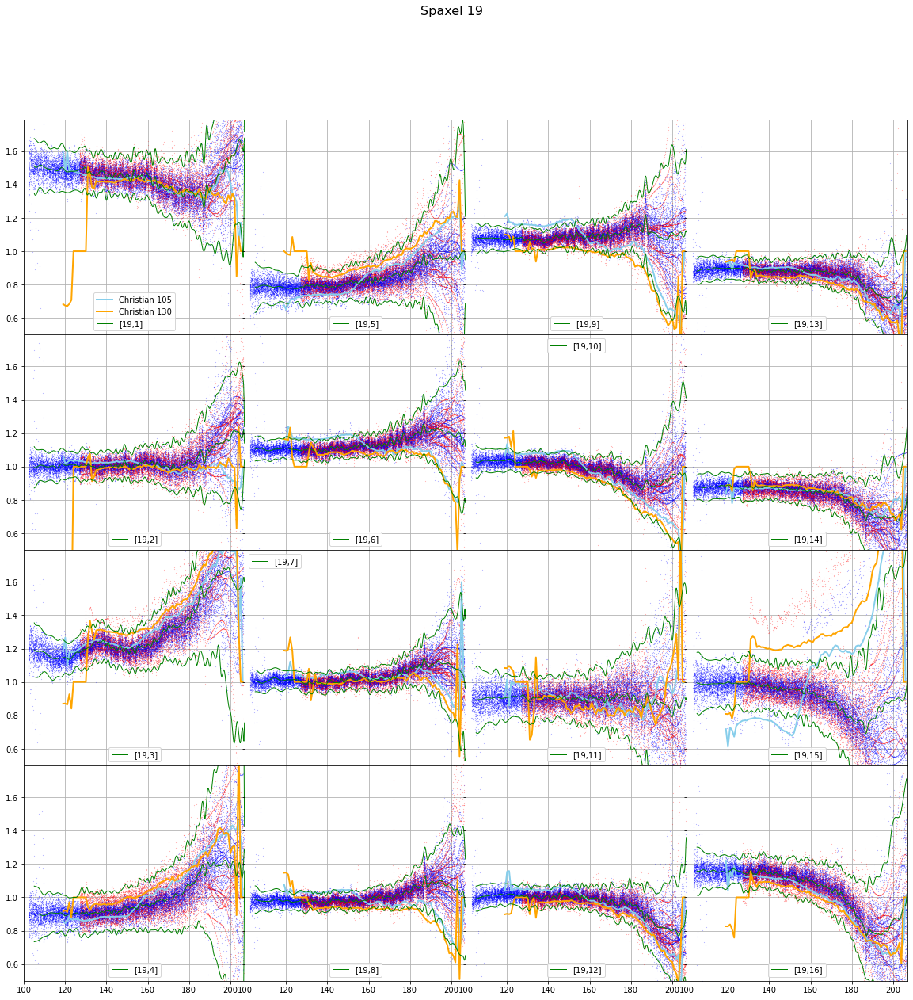

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)


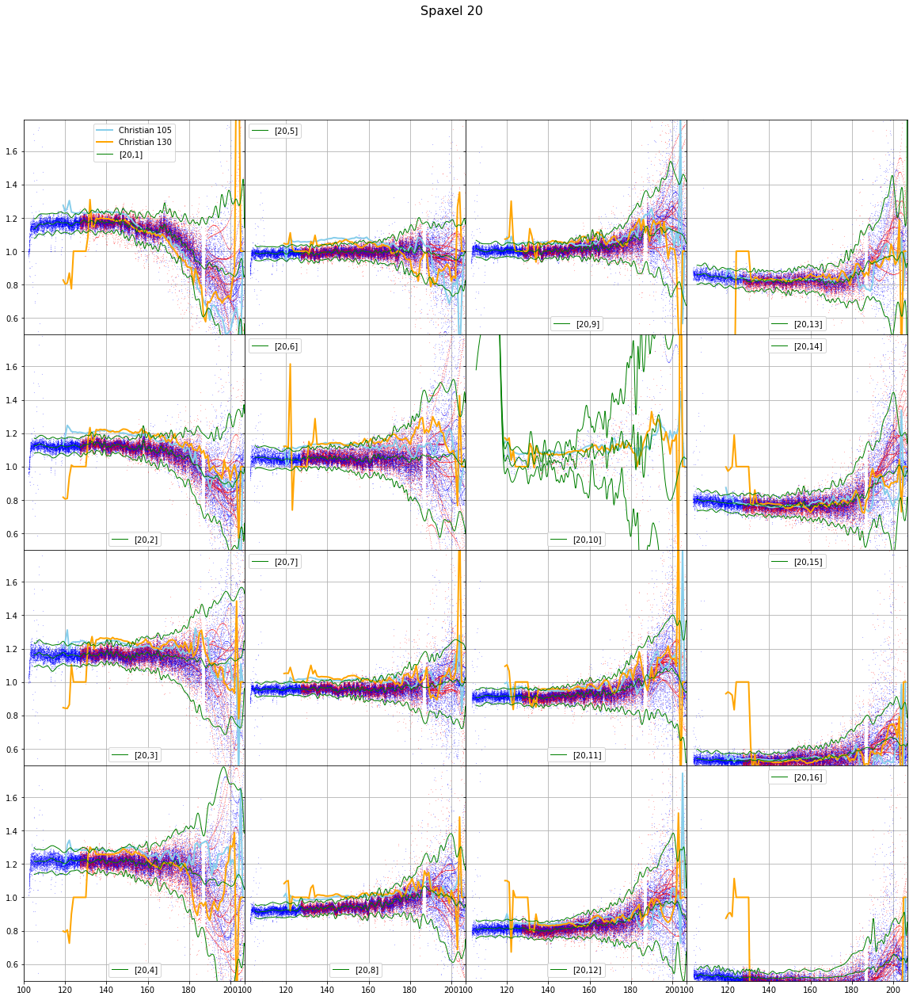

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anacon

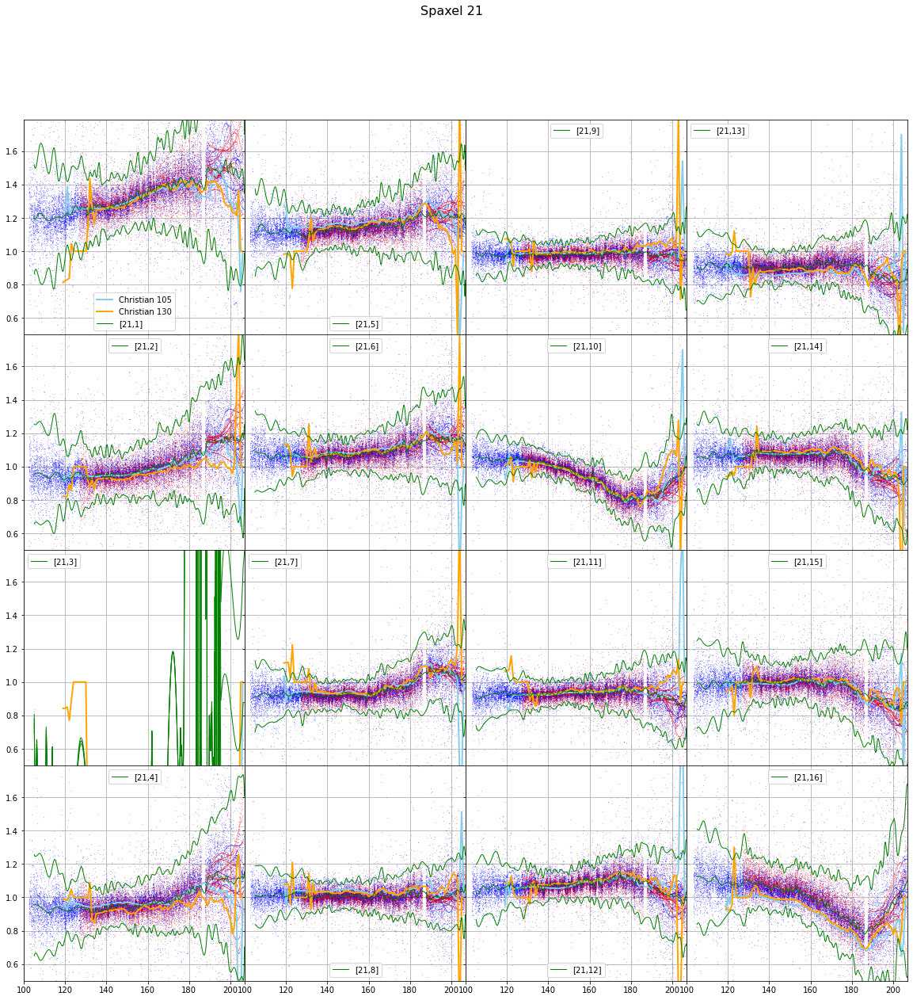

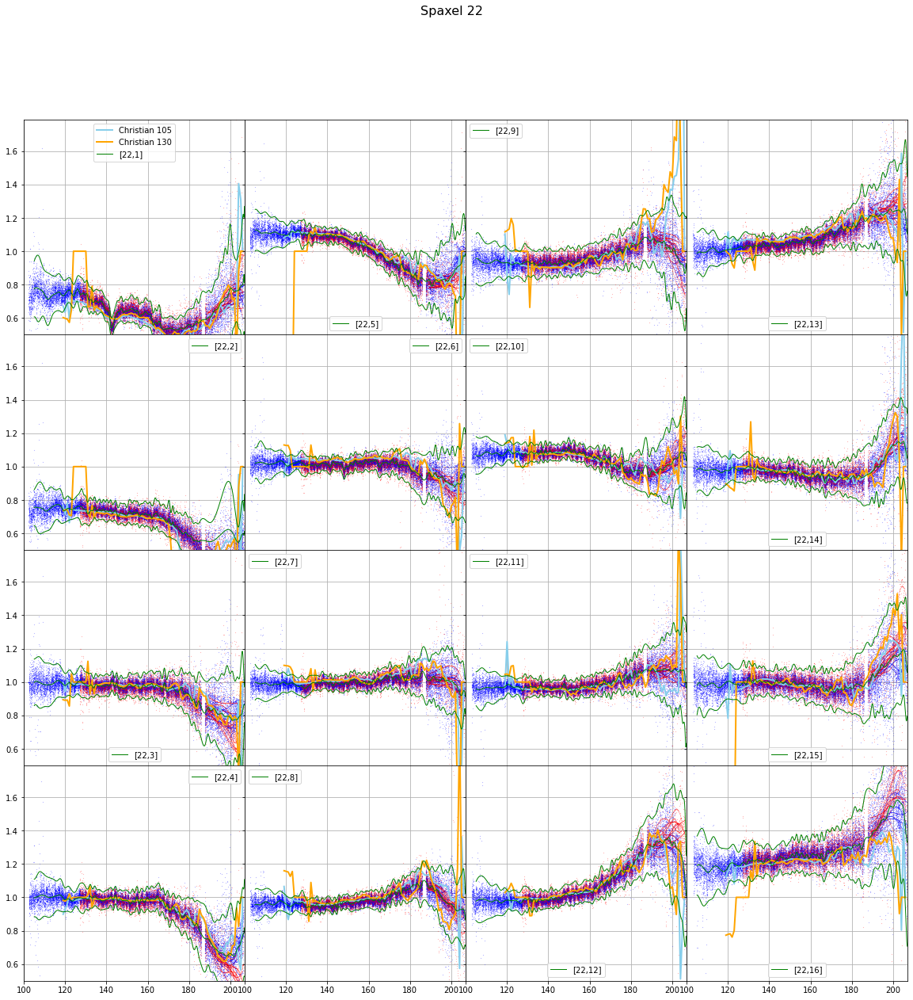

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)


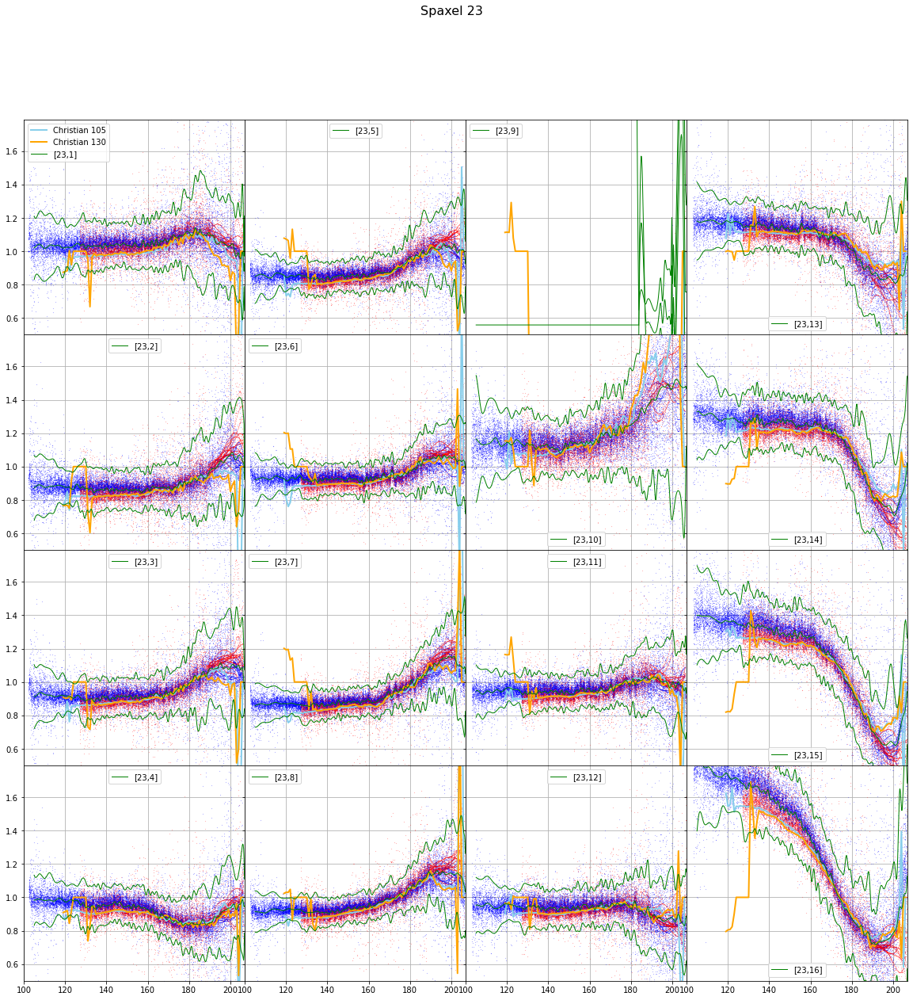

/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:993: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)


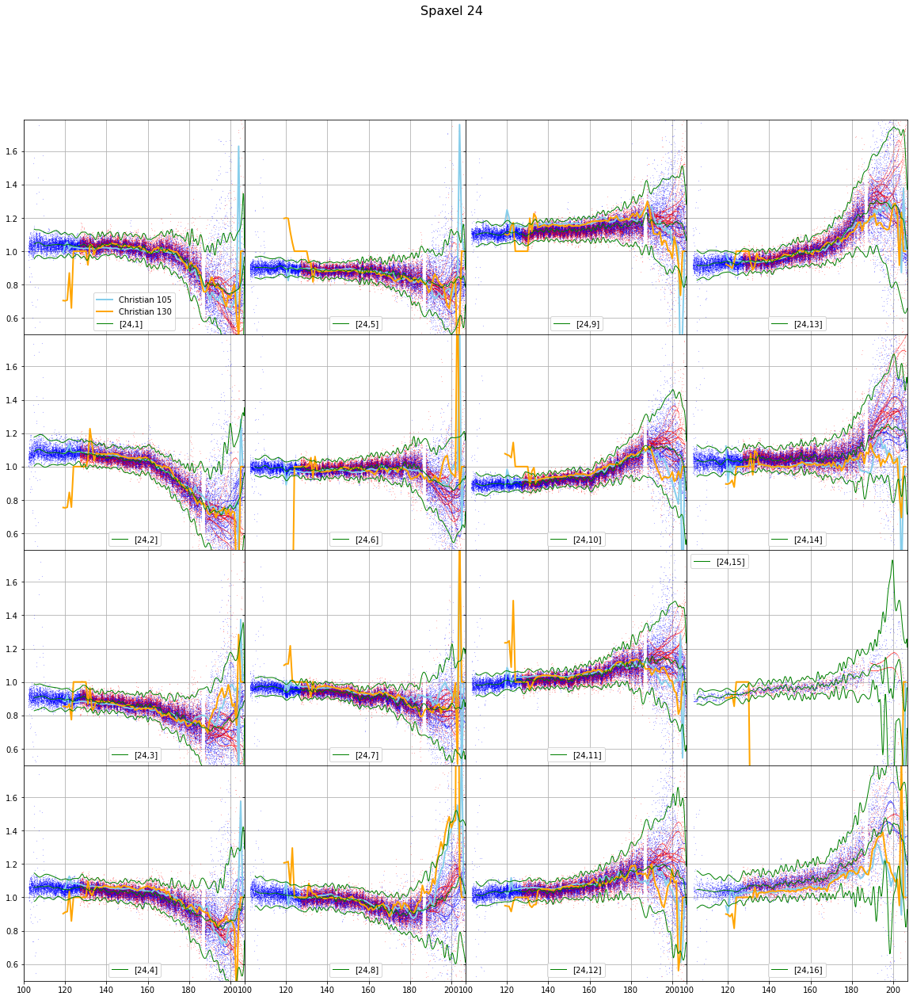

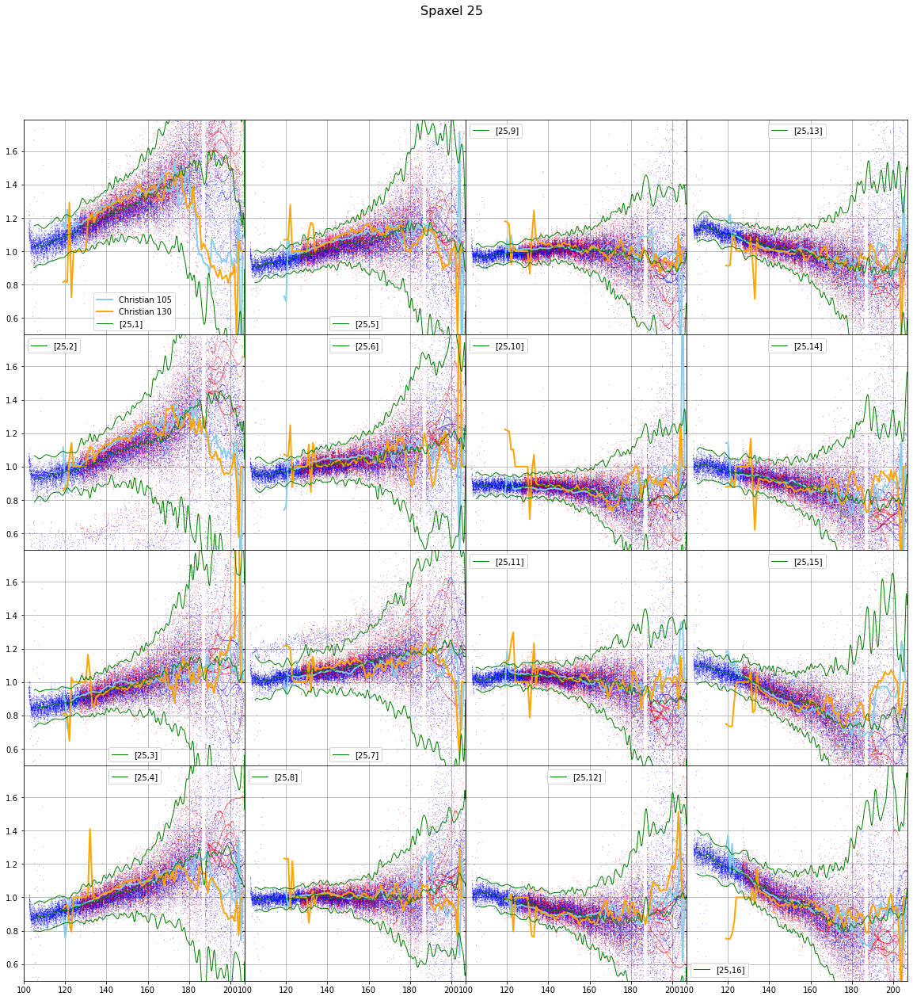

In [59]:
%matplotlib inline
from fifipy.spectra import computeFlatRed
wdario = np.arange(105,207,0.2)
fdario = np.ones((np.size(wdario),25,16))
efdario = np.ones((np.size(wdario),25,16))
badpix = np.zeros((25,16))
noisepix = np.zeros((25,16))
w = waves[0]
for ispax in range(25):
    # Flats
    fig,axes = plt.subplots(4,4,figsize=(20,20), sharex=True, sharey=True)
    for ispex in range(16):
        flats = computeFlatRed(waves, corrSpectra, spatspectra, ispax, ispex, delta=1.2)
        ax = axes[ispex % 4, ispex // 4]
        for s,ss,d in zip(corrSpectra, spatspectra, dichroics):
            if d == 105:
                color = 'blue'
            else:
                color = 'red'
            ax.plot(w,s[ispax*16+ispex]/ss[ispax],'.',markersize=0.2,color=color,linewidth=0.5)
        if ispex == 0:
            ax.plot(wch, f105[:,ispax,ispex],color='skyblue',label='Christian 105',linewidth=2)
            ax.plot(wch, f130[:,ispax,ispex],color='orange',label='Christian 130',linewidth=2)
        else:
            ax.plot(wch, f105[:,ispax,ispex],color='skyblue', linewidth=2)
            ax.plot(wch, f130[:,ispax,ispex],color='orange', linewidth=2)
        if flats is not None:
            flat,eflat=flats
            f = flat(wdario)
            ef = eflat(wdario)
            ax.plot(wdario,f,color='green',label='['+str(ispax+1)+','+str(ispex+1)+']',linewidth=1.)
            ax.plot(wdario,f+3*ef,color='green',linewidth=1.)
            ax.plot(wdario,f-3*ef,color='green',linewidth=1.)
            fdario[:,ispax,ispex] = f
            efdario[:,ispax,ispex] = ef
        else:
            badpix[ispax,ispex] = 1
            #badpix.append((ispax+1, ispex+1))
        noisepix[ispax,ispex] = np.nanmean(f/ef)
        # print(ispax+1, ispex+1, re)
        ax.set_xlim([100,207])
        ax.set_ylim([0.5,1.79])
        ax.grid()
        ax.legend()
    plt.subplots_adjust(wspace=0, hspace=0)
    fig.suptitle('Spaxel '+str(ispax + 1), fontsize=16)
    #fig.subplots_adjust(top=0.88)
    plt.show()


58.610368753745455 0.0


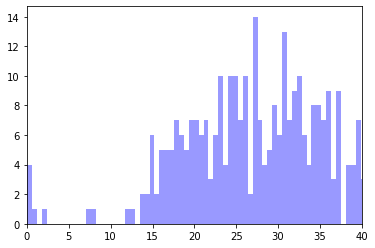

In [60]:
# This only for a series
# Histogram of signal/noise for flats

snr = noisepix.ravel()
idx = (snr > 99) | (snr < 0)
snr[idx] = 0
n, bins, patches = plt.hist(snr,100, facecolor='blue', alpha=0.4)
print(np.max(snr),np.min(snr))
plt.xlim(0,40)
plt.show()

In [11]:
# Bad pixels
print('Bad pixels')
for ispax in range(25):
    for ispex in range(16):
        if badpix[ispax, ispex]:
               print('{:2d} {:2d}'.format(ispax+1,ispex+1))
                
# Noisy pixels
print('Noisy pixels')
for ispax in range(25):
    for ispex in range(16):
        if noisepix[ispax, ispex] < 24:
               print('{:2d} {:2d}'.format(ispax+1,ispex+1))



Bad pixels
 2  1
 2 16
 5  5
 7 15
16  3
16  7
16  9
16 11
16 13
17  4
18 10
18 11
18 13
20 10
23  9
24 15
24 16
Noisy pixels
 3  1
 3  2
 3  3
 3  4
 3  5
 3  6
 3  7
 3  8
 3  9
 3 10
 3 11
 3 12
 3 13
 3 14
 3 15
 3 16
 4 16
 5  8
 5 11
16  2
16  3
19  2
19  3
19 11
19 15
21  1
21  2
21  3
21  4
21  5
21  6
21  7
21  8
21  9
21 10
21 11
21 12
21 13
21 14
21 15
21 16
22  2
23 10


 2  1 1.00
 2 16 1.00
 3  1 0.38
 3  2 0.36
 3  3 0.37
 3  4 0.36
 3  5 0.38
 3  6 0.41
 3  7 0.37
 3  8 0.39
 3  9 0.37
 3 10 0.38
 3 11 0.37
 3 12 0.38
 3 13 0.38
 3 14 0.38
 3 15 0.37
 3 16 0.39
 5  5 1.00
 5 11 0.16
 7 15 1.00
16  3 1.00
16  7 1.00
16  9 1.00
16 11 1.00
16 13 1.00
17  4 1.00
18 10 1.00
18 11 1.00
18 13 1.00
19  3 0.10
19 15 0.10
20 10 1.00
21  1 0.35
21  2 0.38
21  3 0.39
21  4 0.40
21  5 0.39
21  6 0.39
21  7 0.36
21  8 0.37
21  9 0.37
21 10 0.37
21 11 0.37
21 12 0.39
21 13 0.35
21 14 0.37
21 15 0.37
21 16 0.36
23  9 1.00
24 15 1.00
24 16 1.00


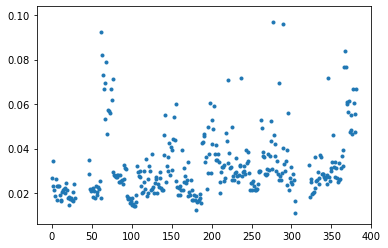

0.22131019747924105


In [12]:
totnoise = []
for ispax in range(25):
    for ispex in range(16):
        noise = np.nanmean(efdario[:,ispax,ispex])
        if noise == 1:
            #print(ispax+1, ispex+1, 'bad')
            print("{0:2d} {1:2d} {2:.2f}".format(ispax+1, ispex+1, noise))
        elif noise > 0.095:
            #print(ispax+1, ispex+1, noise)
            print("{0:2d} {1:2d} {2:.2f}".format(ispax+1, ispex+1, noise))
            totnoise.append(noise)
        elif noise > 0.01:
            totnoise.append(noise)
            #print('noise ', noise)
plt.plot(totnoise,'.')
mt = np.nanmedian(totnoise)
ms = np.nanmedian(np.abs(totnoise-mt))

plt.ylim([mt-3*ms,mt+10*ms])
plt.show()
print(np.median(totnoise)+2*np.std(totnoise))


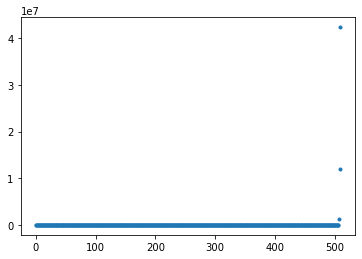

In [62]:
ispax=8
ispex=2
plt.plot(efdario[:,ispax,ispex],'.')


# Flats

In [61]:
# Blend the two flats (spaxel and spexels)
w = waves[0]

# For D105 we use the entire wavelength range (105-207)
w105 = wdario
spexelSpectralFlatR1D105 = fdario.copy()
efR1D105 = efdario.copy()
print(np.shape(spexelSpectralFlatR1D105))
for ispax, sft in enumerate(spaxelSpectralFlatA):
    sft_ = np.interp(w105, w, sft)
    for ispex in range(16):
        spexelSpectralFlatR1D105[:,ispax,ispex] *= sft_

# For D130 we need only the range 125-207        
idx, = np.where( (wdario >= 125) & (wdario <= 207))
w130 = wdario[idx]
efR1D130 = efdario[idx,:,:].copy()
spexelSpectralFlatR1D130 = fdario[idx,:,:].copy()
print(np.shape(spexelSpectralFlatR1D130))
for ispax, sft in enumerate(spaxelSpectralFlatB):
    sft_ = np.interp(w130, w, sft)
    for ispex in range(16):
        spexelSpectralFlatR1D130[:,ispax,ispex] *= sft_


(510, 25, 16)
(410, 25, 16)


In [62]:
# Save spatial flats for the different missions
caldir = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/'
longdates = []
for ud in udates:
    ud_ = str.split(ud,'/')
    longdates.append('20'+ud_[1]+'{:0>2}'.format(ud_[0])+'01')
longdates = np.array(longdates)
idx = np.argsort(longdates)
sld = longdates[idx]
sss = [ssi[i] for i in idx]

sld = list(sld)
sld.append('99999999')

caldir = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/'
# Save spatial flats in a txt file
title = np.array(['date','p0','p1','p2','p3','p4','p5','p6','p7','p8','p9','p10','p11','p12','p13','p14','p15','p16',
         'p17','p18','p19','p20','p21','p22','p23','p24'])
separator='\t'
with open(caldir+'spatialFlatR.txt','wb') as f:
    np.savetxt(f, [separator.join(title)],fmt='%s')
    for ud,si in zip(sld[1:], sss):
        sf = [str(ud)]
        sf.extend(["{:10.8f}".format(fi) for fi in si])
        np.savetxt(f, [separator.join(sf)],fmt='%s')

In [63]:
# Save the spectral flats
import os
caldir = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/'

from fifipy.io import saveSpecFlats
saveSpecFlats(w105, spexelSpectralFlatR1D105, efR1D105,'RED', 1, 105, caldir+'spectralFlatsR1D105.fits')
saveSpecFlats(w130, spexelSpectralFlatR1D130, efR1D130,'RED', 1, 130, caldir+'spectralFlatsR1D130.fits')


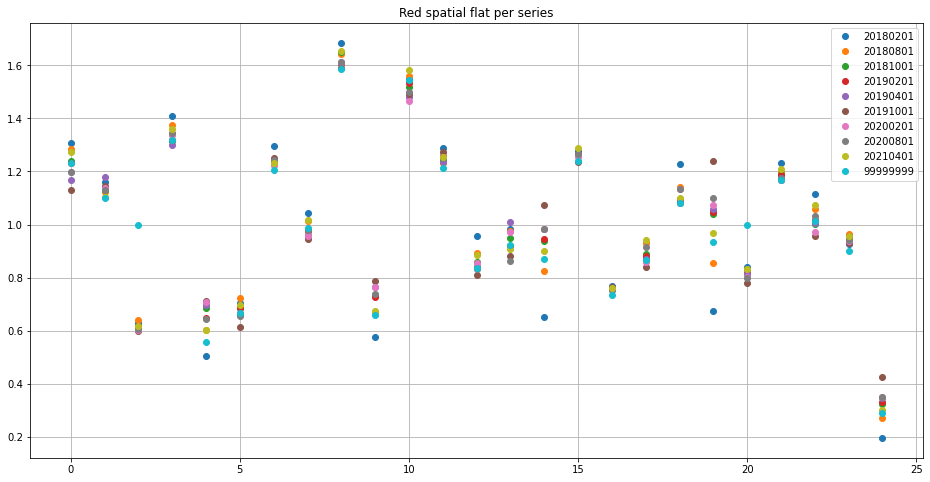

In [64]:
# Comparison of pixel illumination (constant spatial flats)
data = np.loadtxt('/Users/dfadda/sofia/FIFI-LS/SpectralFlats/spatialFlatR.txt', skiprows=1)
dates = data[:,0]
flats = data[:,1:]
fig,ax = plt.subplots(figsize=(16,8))
for f, date in zip(flats, dates):
    ax.plot(f,'o',label=str(int(date)))
ax.grid()
ax.set_title('Red spatial flat per series')
ax.legend()
plt.show()

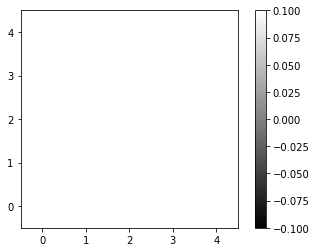

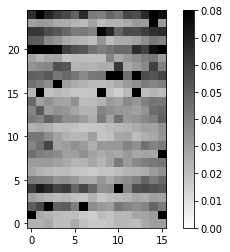

In [62]:
if Test:
    # Spatial illumination
    spaflat2d = np.reshape(s1,(5,5))
    plt.imshow(spaflat2d, cmap='gray', origin='lower')
    plt.colorbar()
    plt.show()
    # Errors
    ef = np.nanmedian(efdario/fdario, axis=0)
    plt.imshow(ef, cmap='gray_r', origin='lower')
    plt.colorbar()
    plt.clim(0,.08)
    plt.show()

In [14]:
if Test:
    # Saving spatial flats as FITS table
    from astropy.io import fits
    col1 = fits.Column(name='expdate', format='K', array=dd)
    col2 = fits.Column(name='flat', format='25D')
    coldefs = fits.ColDefs([col1, col2])
    hdu = fits.BinTableHDU.from_columns(coldefs)
    outfile='test.fits'
    hdu.writeto(caldir + outfile, overwrite=True)